<img src="https://drive.google.com/uc?export=view&id=1x-QAgitB-S5rxGGDqxsJ299ZQTfYtOhb" width=180, align="center"/>

Master's degree in Intelligent Systems

Subject: 11754 - Deep Learning

Year: 2023-2024

Professor: Miguel Ángel Calafat Torrens

This notebook has been correctly executed with the versions below on Google Colab:

- python=3.10.12
- ultralytics=8.0.201
- ffmpeg=1.4

Feel free to create a virtual environment with these versions to make your own executions locally.

# FINAL LAB - MASKS DATASET AND SKYFUSION DATASET

**Object Detection** is a computer vision task that involves identifying and locating objects of interest within an image or video frame. Unlike image classification, where the task is to assign a label to an entire image, object detection aims to identify multiple objects and their locations within the same image.

**How Object Detection Works:**

**Bounding Boxes:** Objects are typically represented by bounding boxes. Each bounding box is defined by coordinates (usually the top-left and bottom-right corners) that encapsulate the object.

**Class Labels:** Along with the bounding box, each detected object is associated with a class label (e.g., "person", "car", "bicycle").

There are various neural network architectures designed specifically for object detection. Some popular ones include:

 * R-CNN and its variants (Fast R-CNN, Faster R-CNN): These methods use region proposal networks to suggest potential object locations and then classify each region.

 * YOLO (You Only Look Once): This approach divides the image into a grid and predicts bounding boxes and class probabilities for each grid cell in a single pass.

 * SSD (Single Shot MultiBox Detector): Like YOLO, SSD detects objects in a single forward pass of the network but uses multiple feature maps at different scales to detect objects of various sizes.

In this final lab we will be using YOLO as an inference pipeline.

YOLO is a reference in computer vision, so you probably heard something about it.

Let's start with a bit of history.

## Introduction

Below is a brief summary of YOLO history. Perhaps you are interested in going deeper into some of the aspects mentioned below. Please, see [this link](https://deci.ai/blog/history-yolo-object-detection-models-from-yolov1-yolov8/) for more information or read [this paper](https://arxiv.org/pdf/2304.00501.pdf).

### YOLOv1 ([paper](https://www.cv-foundation.org/openaccess/content_cvpr_2016/papers/Redmon_You_Only_Look_CVPR_2016_paper.pdf))

Before the advent of YOLO, traditional object detection methods relied on a two-step process: first, they would generate potential bounding boxes in the image, and then they would classify each box. This approach was not only computationally intensive but also slower in real-time scenarios. The need to process multiple regions in an image and then classify each one made these methods less efficient and less suited for real-time applications.

YOLOv1 revolutionized object detection in June 2016 by introducing a single-stage process. Instead of treating the detection problem as a two-step process (region proposal followed by classification), YOLO proposed a unified model that looked at the image only once and predicted bounding boxes and class probabilities in one forward pass. This approach was not only faster but also more efficient, making real-time object detection feasible. The original YOLO model emphasized high-speed object detection, making it stand out from its predecessors.

<img src="https://drive.google.com/uc?export=view&id=1Z718kU6VqjFlPImbkiQoM3Z1GxGEd9_r" width=500, align="center"/>

Source: https://pjreddie.com/darknet/yolo/

### YOLOv2
YOLOv2 (July 2017) incorporated batch normalization and a high-resolution classifier was added, resulting in better performance for higher-resolution inputs.

Furthermore, in incorporated anchor boxes. One of the main drawbacks of YOLOv1 was its poor performance in localizing boxes since bounding boxes were learned entirely from data. YOLOv2 introduced anchor boxes (priors) to aid localization. This change allowed a cell to predict different objects with different boxes, enhancing recall.

### YOLOv3
YOLOv3 (April 2018) enhanced accuracy and efficiency by introducing multi-scale detection, a new architecture, and changes in prediction strategy and loss function.

* Multi-scale detection: Detects objects of various sizes using three different sizes of anchor boxes.
* Darknet-53 Architecture: It incorporates a new hybrid of Darknet-19 and ResNet architecture.
* Class Prediction: It uses logistic classifiers instead of Softmax for better multi-label classification.
* Loss Function: It modified the loss function to balance objectness score and classification loss.

### YOLOv4
YOLOv4 (April 2020) builds upon the foundation of YOLOv3 by introducing several advancements in object recognition, making it faster and more accurate.

Among other changes, it also incorporates new strategies to improve its performance without significantly increasing computational cost, such as Bag of Freebies (BoF) and Bag of Specials (BoS). BoF includes methods that don't add extra inference cost but improve training, while BoS includes methods that might add a little inference cost but provide a significant boost in performance.

### YOLOv5
YOLOv5 (June 2020) was released just a couple of months before it’s predecessor and it was some [controversy about the name](https://news.ycombinator.com/item?id=23480884).

This YOLO version was released by a company called Ultralytics and it was available through a [GitHub repository](https://github.com/ultralytics/yolov5). This approach made it more accessible to the developer community, allowing for immediate implementation and feedback.
One key point is that it was developed using [PyTorch](https://pytorch.org/) instead of [DarkNet](https://pjreddie.com/darknet/).

### YOLOv6

YOLOv6 (September 2022) demonstrated stronger performance than its predecessor, YOLOv5, especially when benchmarked against the MS COCO dataset.

It introduced significant changes to its architecture:

* EfficientRep Backbone and Rep-PAN Neck: YOLOv6 redesigned the YOLO backbone and neck with hardware efficiency in mind. The model introduced the EfficientRep Backbone and a Rep-PAN Neck.
* Decoupled Head: Unlike previous YOLO models where classification and box regression heads shared the same features, YOLOv6 decoupled the head. This separation of features led to an empirical increase in model performance.
* Training Enhancements: The YOLOv6 repository incorporated improvements to the training pipeline, including anchor-free training, SimOTA tag assignment, and SIoU box regression loss.


### YOLOv7

YOLOv7 (July 2022) introduced several key enhancements over its predecessors:

* Extended Efficient Layer Aggregation (E-ELAN): Optimized the efficiency of convolutional layers for faster inference.
* Model Scaling Techniques: Scaled the network depth and width together for optimal model architectures across different sizes.
* Re-parameterization Planning: Used gradient flow paths to determine which network modules should employ re-parameterization strategies.
* Auxiliary Head Coarse-to-Fine Approach: Added a mid-network auxiliary head with varying supervision levels to improve training efficiency.
These improvements aimed to boost YOLOv7's object detection accuracy while maintaining competitive inference speeds.

### YOLOv8

[Ultralytics](https://www.ultralytics.com/), the company behind YOLOv5, released YOLOv8 in January 2023. As of now, there isn't a detailed paper discussing the specifics of YOLOv8, but it's evident that with each iteration, the YOLO series has aimed to strike a balance between accuracy and speed, making it one of the most preferred object detection inference pipeline in the industry.

Furthermore, this inference pipeline is not only designed for object detection, but it also incorporates image classification, instance segmentation, pose estimation and object tracking.

YOLOv8's Unique Features:
* Anchor-Free Detection: Unlike previous versions that relied on anchor boxes, YOLOv8 is an anchor-free model. This means it predicts the center of an object directly, eliminating the complexities associated with anchor boxes.
* New Convolutions: The model introduced changes in its convolutional layers, including replacing the stem's first 6x6 convolution with a 3x3 and introducing a new module called C2f, which offers a more streamlined approach than the previous C3 module.
* Mosaic Augmentation: This augmentation technique stitches four images together, enhancing the model's ability to recognize objects in varying locations and conditions. However, it's turned off for the last ten training epochs to optimize performance.

Developer Experience:
* YOLOv8 introduces a user-friendly interface via a PIP package, making it easier for developers to integrate and use the model.
* The [YOLOv8 code repository](https://github.com/ultralytics/ultralytics) is designed for community use and iteration, with the expectation of continuous improvements and updates.

## Recomendations

This practice can be done just using the information from Ultralytics that you'll find [in its docs](https://docs.ultralytics.com/) and [in its repo](https://github.com/ultralytics/ultralytics). I highly recommend that you check it out and spend some time getting familiar with it.

## Set up

So now that you know what is this all about, let's start.

In [ ]:
# Select your path as in the practices and execute it
MY_GDRIVE_PATH = '/content/gdrive/MyDrive/Colab Notebooks/deep learning/final lab'


# Connect to your drive
from google.colab import drive
drive.mount('/content/gdrive')
%cd {MY_GDRIVE_PATH}
%ls -l

# Here the path of the project folder (which is where this file is) is inserted
# into the python path.
from pathlib import Path
import sys

PROJECT_DIR = str(Path().resolve())
sys.path.append(PROJECT_DIR)

Mounted at /content/gdrive
/content/gdrive/MyDrive/Colab Notebooks/deep learning/final lab
total 3036
-rw------- 1 root root    2521 May  6 13:40 coco.yaml
drwx------ 2 root root    4096 May  6 15:21 data/
drwx------ 2 root root    4096 May  6 14:27 dataset/
-rw------- 1 root root    4439 May 26 16:26 Enunciado.ipynb
-rw------- 1 root root 3049950 May 26 16:28 FinalLab.ipynb
drwx------ 2 root root    4096 May 25 18:51 inference/
-rw------- 1 root root   22256 May  6 13:40 project_helper.py
drwx------ 2 root root    4096 May  6 14:09 __pycache__/
drwx------ 2 root root    4096 May 25 18:51 runs/
drwx------ 2 root root    4096 May 25 23:30 SkyFusion/
drwx------ 2 root root    4096 May 26 16:23 SQUATS/


In [ ]:
# Install YOLOv8
%pip install ultralytics==8.1

# Also install this library to record, convert and stream video
%pip install ffmpeg==1.4

from ultralytics import YOLO, checks
checks()

Ultralytics YOLOv8.1.0 🚀 Python-3.10.12 torch-2.3.0+cu121 CPU (Intel Xeon 2.20GHz)
Setup complete ✅ (2 CPUs, 12.7 GB RAM, 29.9/107.7 GB disk)


In [ ]:
# Feel free to use more libraries
import os
import random
import numpy as np
import matplotlib.pyplot as plt
import project_helper as ph
from importlib import reload

In [ ]:
# Use it if you modify project_helper.py
# reload(ph)

## Datasets and annotation type in Object Detection

In YOLO object detection, the annotation format typically used for training is called the **Darknet annotation format**.

The Darknet annotation format consists of **a text file for each image** in your training dataset. Each text file contains lines that describe the objects (bounding boxes) present in the corresponding image. Each line in the annotation file follows a specific format as shown in following figure.

<img src="https://drive.google.com/uc?export=view&id=1C4skRQnV2b9CA0ATj5KjNY-0jwCNnIE9" width=700, align="center"/>


`<object-class>`: This is an integer representing the class label or ID of the object detected in the image. Class IDs typically start from 0 and increase for each unique object class.

`<x>`: The x-coordinate of the center of the bounding box, normalized to the width of the image. This means that 0 represents the left edge of the image, and 1 represents the right edge.

`<y>`: The y-coordinate of the center of the bounding box, normalized to the height of the image. 0 represents the top edge of the image, and 1 represents the bottom edge.

`<width>`: The width of the bounding box, also normalized to the width of the image.

`<height>`: The height of the bounding box, normalized to the height of the image.

Here's an example of what an entry in a Darknet annotation file might look like (note that numbers are separated by single spaces):

```
0 0.31 0.22 0.08 0.77
```

In [ ]:
# Create a folder in which we'll leave the images
# used for inference

# Create inference folder
!mkdir inference

# Create inference/photos folder
!mkdir inference/photos

# Go to inference folder
%cd inference/photos

# Download an example photo in this folder
!gdown "1uzWLdk_13EdyOaVxlvIoo3AMSoLXbHJg" -O example01.jpg

# And go back to the project folder
%cd ../..

mkdir: cannot create directory ‘inference’: File exists
mkdir: cannot create directory ‘inference/photos’: File exists
/content/gdrive/MyDrive/Colab Notebooks/deep learning/final lab/inference/photos
Downloading...
From: https://drive.google.com/uc?id=1uzWLdk_13EdyOaVxlvIoo3AMSoLXbHJg
To: /content/gdrive/MyDrive/Colab Notebooks/deep learning/final lab/inference/photos/example01.jpg
100% 1.68M/1.68M [00:00<00:00, 100MB/s]
/content/gdrive/MyDrive/Colab Notebooks/deep learning/final lab


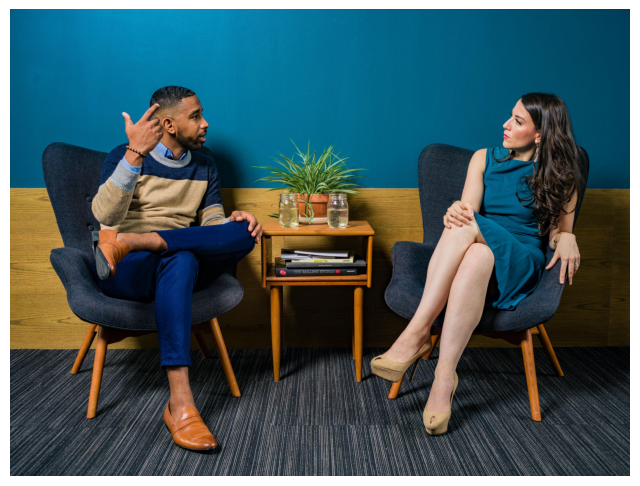

In [ ]:
# Convert the string into a Path object
path_object = os.path.join(PROJECT_DIR, "inference/photos/example01.jpg")

# Display the original photo
ph.show(path_object)

In [ ]:
# Load a pretrained YOLOv8n detection model
model = YOLO('yolov8n.pt')

In [ ]:
# Predict with the model on the image downloaded
results = model(source=path_object,
                show=False,
                conf=0.3,
                save=True)


image 1/1 /content/gdrive/MyDrive/Colab Notebooks/deep learning/final lab/inference/photos/example01.jpg: 512x640 2 persons, 2 chairs, 1 potted plant, 666.5ms
Speed: 19.9ms preprocess, 666.5ms inference, 31.8ms postprocess per image at shape (1, 3, 512, 640)
Results saved to runs/detect/predict2


In [ ]:
# As informed in the output cell above, the results
# have been saved
print(f'Results saved to {results[0].save_dir}')

Results saved to runs/detect/predict2


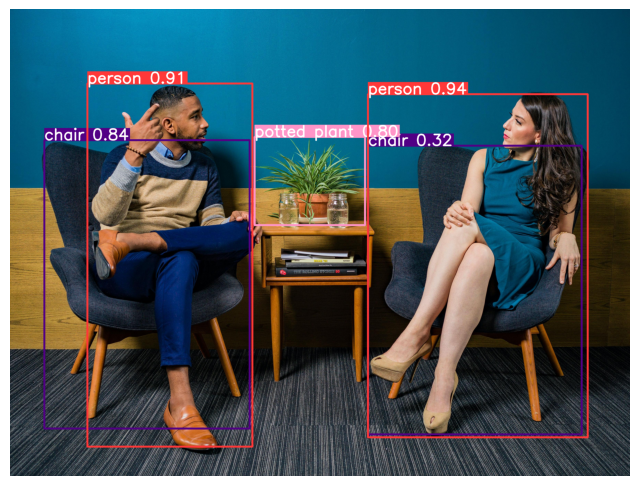

In [ ]:
# Display the results
ph.show(results)

Explore the 'results' object. You'll find that it has quite a lot of information in it, as you can see in [the documentation](https://docs.ultralytics.com/reference/engine/results/#ultralytics.engine.results.Boxes)

In [ ]:
print(results[0].boxes)

ultralytics.engine.results.Boxes object with attributes:

cls: tensor([ 0.,  0., 56., 58., 56.])
conf: tensor([0.9445, 0.9107, 0.8365, 0.8028, 0.3158])
data: tensor([[2.0781e+03, 4.9481e+02, 3.3544e+03, 2.4868e+03, 9.4453e-01, 0.0000e+00],
        [4.4917e+02, 4.3214e+02, 1.4078e+03, 2.5403e+03, 9.1066e-01, 0.0000e+00],
        [1.9987e+02, 7.6153e+02, 1.3916e+03, 2.4356e+03, 8.3654e-01, 5.6000e+01],
        [1.4208e+03, 7.4204e+02, 2.0611e+03, 1.2546e+03, 8.0275e-01, 5.8000e+01],
        [2.0797e+03, 7.9392e+02, 3.3194e+03, 2.4696e+03, 3.1578e-01, 5.6000e+01]])
id: None
is_track: False
orig_shape: (2711, 3600)
shape: torch.Size([5, 6])
xywh: tensor([[2716.2554, 1490.7947, 1276.2256, 1991.9644],
        [ 928.4995, 1486.2238,  958.6573, 2108.1599],
        [ 795.7563, 1598.5513, 1191.7770, 1674.0435],
        [1740.9800,  998.3352,  640.2802,  512.5843],
        [2699.5435, 1631.7646, 1239.6443, 1675.6802]])
xywhn: tensor([[0.7545, 0.5499, 0.3545, 0.7348],
        [0.2579, 0.5482, 0.26

Once explored, answer the following questions using code (and **extracting the info from 'results'**):

In [ ]:
# How many bounding boxes have your model found?
# Of course you know the solution is 5, but I don't want you to just type 5,
# you have to extract the number of boxes from 'results'
val = len(results[0].boxes)
val = results[0].boxes.shape[0]
print(f'The number of bounding boxes found are: {val}')

The number of bounding boxes found are: 5


In [ ]:
# What's the width of the third bounding box in the range [0-1] (relative to
# the width of the image). Return the result as a single value, not a tensor or
# a numpy array.

b3 = 2  # The third bounding box index
val = results[0].boxes.xywhn[b3, 2].item()
print(f'The width of the third bounding box is: {val}')

The width of the third bounding box is: 0.3310491740703583


In [ ]:
# What coordinates (in pixels) has the center of the second bounding box found
# in the figure. Return the result as a tuple of values, i.e. "(928.5, 1486.2)"
# an not as a tensor or a numpy array
b2 = 1  # The second bounding box index
val = tuple(np.array(results[0].boxes.xywh[b2, :2].cpu()))
print(f'The coords of the center of the second bounding box are: {val}')

The coords of the center of the second bounding box are: (928.49945, 1486.2238)


In [ ]:
# What is the model's confidence in the result of the first bounding box?
# Return the result as a single value, not a tensor or a numpy array.
b1 = 0  # The first bounding box index
val = results[0].boxes.conf[b1].cpu().item()
print(f'The confidence of the first bounding box is are: {val}')

The confidence of the first bounding box is are: 0.9445313811302185


In [ ]:
# Ok, now extract the same data asked in the last 4 cells above
# but in this case get it from the raw bbox tensor 'data'

img_shape = results[0].boxes.orig_shape
dt = results[0].boxes.data.cpu()

# How many bounding boxes are there in the image?
val1 = dt.shape[0]
print(f'The number of bounding boxes found are: {val1}')

# What's the width of the third bounding box in the range [0-1]?
b3 = 2  # The third bounding box index
val2 = (dt[b3, 2] - dt[b3, 0]) / img_shape[1]
print(f'The width of the third bounding box is: {val2}')

# What coordinates (in pixels) has the center of the second bounding box found
# in the figure. Return the result as a tuple of values.
b2 = 1  # The second bounding box index
val3 = (((dt[b2, 2] - dt[b2, 0]) / 2 + dt[b2, 0]).item(),
        ((dt[b2, 3] - dt[b2, 1]) / 2 + dt[b2, 1]).item())
print(f'The coords of the center of the second bounding box are: {val3}')

# What is the model's confidence in the result of the first bounding box?
b1 = 0  # The first bounding box index
val4 = dt[b1, 4].item()
print(f'The confidence of the first bounding box is are: {val4}')

The number of bounding boxes found are: 5
The width of the third bounding box is: 0.3310491740703583
The coords of the center of the second bounding box are: (928.4994506835938, 1486.2237548828125)
The confidence of the first bounding box is are: 0.9445313811302185


You've already seen a usecase of object detection with YOLO. In this case the model has detected persons, chairs and a potted plant. But, what classes can it detect by default?

To see the full list of objects detectable by YOLOv8 by default, you just have to check the dataset in which it was trained on: [the COCO dataset](https://docs.ultralytics.com/datasets/detect/coco/#dataset-yaml)

You have the coco.yaml file in the folder you have been given, so extract the conversions dict and list with the code below.

In [ ]:
# Extract data from yaml file
id2class, class2id = ph.load_classes_from_yaml('coco.yaml')

In [ ]:
# See the class names found in the image
[id2class[int(id)] for id in results[0].boxes.cls.cpu().tolist()]

['person', 'person', 'chair', 'potted plant', 'chair']

Most of the times, when using public datasets, we already have it annotated. Lest's do some real example to adapt annotations.

First of all go into your kaggle account. Don't you have one? Don't worry. You just have to go to [Kaggle](kaggle.com) and sign in. You can do it directly with your Google account.

Once in Kaggle click on _datasets_ on the left side bar. Now in the text box search for "_face mask detection_" and download the first dataset found.

<img src="https://drive.google.com/uc?export=view&id=19QYsPd3avFuwR_heB1p7iWGZiyAxRl89" width=1000, align="center"/>

Now unzip the original dataset with the following instruction and leave it a folder called 'dataset' at the current path. Also, make sure you rename the "_annotations_" folder to "_annotations_XML_".

In [ ]:
# Define the file paths
zip_file_path = 'archive.zip'
new_folder_path = 'dataset'

# Get annotations names
original_annotations_path = os.path.join(new_folder_path, 'annotations')
renamed_annotations_path = os.path.join(new_folder_path, 'annotations_XML')

# Create a new folder if it doesn't exist
if not os.path.exists(new_folder_path):
    os.makedirs(new_folder_path)

    # Unzip the file into the new folder using the !unzip magic command
    !unzip -q $zip_file_path -d $new_folder_path

    # Rename the 'annotations' folder to 'annotations_XML'
    os.rename(original_annotations_path, renamed_annotations_path)

As you can see, in your _dataset_ directory you have two folders, one for the images and another for annotations.

Let's have a look at some of those images. Note that we're trying to distinguish between three kinds of objects: A face with a mask, a face without a mask, and a face with a mask incorrectly weared.

In [ ]:
# Get a list with image filenames
img_filenames = sorted(ph.list_files_in_folder(
    os.path.join(PROJECT_DIR, "dataset/images"),
    absolute=True))

/content/gdrive/MyDrive/Colab Notebooks/deep learning/final lab/dataset/images/maksssksksss0.png


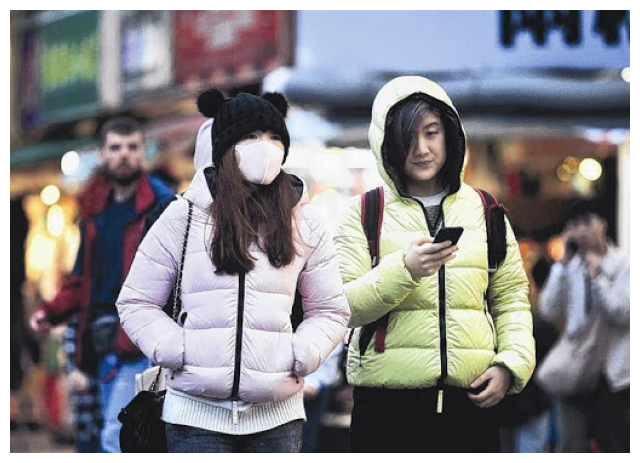

/content/gdrive/MyDrive/Colab Notebooks/deep learning/final lab/dataset/images/maksssksksss1.png


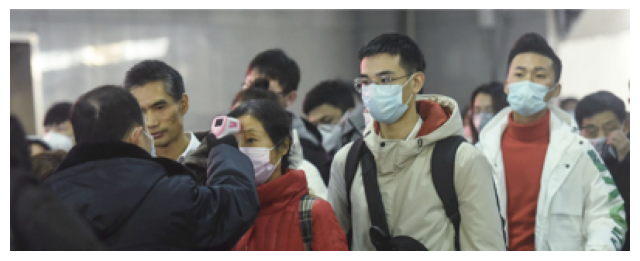

/content/gdrive/MyDrive/Colab Notebooks/deep learning/final lab/dataset/images/maksssksksss132.png


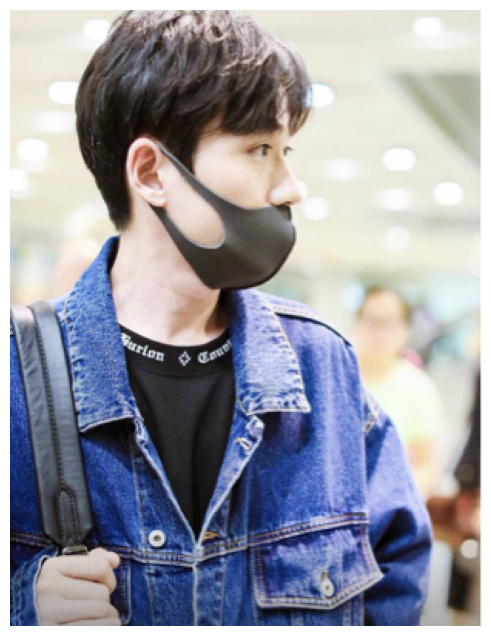

In [ ]:
# See some of those images
for im in (img_filenames[0], img_filenames[1], img_filenames[38]):
    print(im)
    ph.show(im)

Check for the files in the annotations folder, you will see that all of them are XML files, that's why we've renamed as "_annotation_XML_". This usually corresponds to Pascal VOC annotation format.

In [ ]:
# Get a list with annotation filenames
ann_filenames = sorted(ph.list_files_in_folder(
    os.path.join(PROJECT_DIR, "dataset/annotations_XML")))

In [ ]:
# See a XML file with Pascal VOC annotation
# Note that the class names are inside the tags <name></name>
# inside each <object></object>
ann_id = 0
ann_path = os.path.join(PROJECT_DIR, "dataset/annotations_XML",
                       ann_filenames[ann_id])
print(ann_path)
with open(ann_path) as f:
    contents = f.read()
    print(contents)

/content/gdrive/MyDrive/Colab Notebooks/deep learning/final lab/dataset/annotations_XML/maksssksksss0.xml

<annotation>
    <folder>images</folder>
    <filename>maksssksksss0.png</filename>
    <size>
        <width>512</width>
        <height>366</height>
        <depth>3</depth>
    </size>
    <segmented>0</segmented>
    <object>
        <name>without_mask</name>
        <pose>Unspecified</pose>
        <truncated>0</truncated>
        <occluded>0</occluded>
        <difficult>0</difficult>
        <bndbox>
            <xmin>79</xmin>
            <ymin>105</ymin>
            <xmax>109</xmax>
            <ymax>142</ymax>
        </bndbox>
    </object>
    <object>
        <name>with_mask</name>
        <pose>Unspecified</pose>
        <truncated>0</truncated>
        <occluded>0</occluded>
        <difficult>0</difficult>
        <bndbox>
            <xmin>185</xmin>
            <ymin>100</ymin>
            <xmax>226</xmax>
            <ymax>144</ymax>
        </bndbox>
    </obje

As said before, the annotation files are in Pascal VOC format, so we are going to use the following cells to transform them to YOLO Darknet format.

In [ ]:
# Create a new folder for the YOLO Darknet format annotations
new_annot_folder = os.path.join(PROJECT_DIR, 'dataset/annotations')
if not os.path.exists(new_annot_folder):
    os.makedirs(new_annot_folder)

In [ ]:
# Check what class names there are in the annotations
class_names = sorted(ph.get_classes_from_voc("dataset/annotations_XML"),
                     reverse=True)
print(class_names)

['without_mask', 'with_mask', 'mask_weared_incorrect']


Note: In order to correctly follow the next cell, I suggest you take a look at the provided function 'voc_to_yolo'.

In [ ]:
# Define the lambda function to check if the folder is empty
is_folder_empty = lambda folder_path: not os.listdir(folder_path)

# If the folder is empty, do the transformations.
if is_folder_empty(new_annot_folder):
    # Now transform the files from Pascal VOC format to YOLO Darknet format
    ph.voc_to_yolo("dataset/annotations_XML", "dataset/annotations", class_names)

In [ ]:
# Get a list with annotation filenames
ann_filenames = sorted(ph.list_files_in_folder(new_annot_folder))

In the next cell you'll check the YOLO Darknet annotation files. I suggest you try to identify the class number for each class name and verify that it is correct.

In [ ]:
# See a txt file with YOLO Darknet annotation
ann_id = 0  # (0, 1, 38)
with open(os.path.join(PROJECT_DIR, "dataset/annotations",
                       ann_filenames[ann_id])) as f:
    contents = f.read()
    print(contents)

0 0.18359375 0.337431693989071 0.05859375 0.10109289617486339
1 0.4013671875 0.3333333333333333 0.080078125 0.12021857923497267
0 0.6689453125 0.3155737704918033 0.068359375 0.13934426229508196



## Seting up the custom dataset structure

Now we're going to train a model on this custom dataset to be able to predict the objects in an image.

Before training with YOLOv8 you need to have an specific structure of the dataset.

```
dataset/
├── train/
│   ├── images/
│   │   ├── img1_train.png
│   │   └── img2_train.png
│   └── labels/
│       ├── label1_train.txt
│       └── label2_train.txt
├── val/
│   ├── images/
│   │   ├── img1_val.png
│   │   └── img2_val.png
│   └── labels/
│       ├── label1_val.txt
│       └── label2_val.txt
└── test/
    ├── images/
    │   ├── img1_test.png
    │   └── img2_test.png
    └── labels/
        ├── label1_test.txt
        └── label2_test.txt
```

So first of all we're going to arrange the dataset so it suits this structure.

In [ ]:
# Get a list of all image files in the dataset folder
img_filenames = sorted(ph.list_files_in_folder(
    os.path.join(PROJECT_DIR, "dataset/images"),
    absolute=True))

# Get a list of all annotation files in the dataset folder
ann_filenames = sorted(ph.list_files_in_folder(
    os.path.join(PROJECT_DIR, "dataset/annotations"),
    absolute=True))

# Pair the elements of the two lists and shuffle
paired_list = list(zip(img_filenames, ann_filenames))
random.seed(42)
random.shuffle(paired_list)

# Unzip the pairs back into two lists
img_filenames, ann_filenames = zip(*paired_list)

# Select the percentage for testing and validation
test_percent = 18
val_percent = 20
test_size = int(len(img_filenames) * test_percent / 100)
val_size = int(len(img_filenames) * val_percent / 100)

# Select the train, validation and test lists
test_img_filenames = img_filenames[:test_size]
test_ann_filenames = ann_filenames[:test_size]
val_img_filenames = img_filenames[test_size:test_size+val_size]
val_ann_filenames = ann_filenames[test_size:test_size+val_size]
train_img_filenames = img_filenames[test_size+val_size:]
train_ann_filenames = ann_filenames[test_size+val_size:]

In [ ]:
# Create a new folder called "data"
!mkdir data

# Create the subfolders 'train', 'val' and 'test'
!mkdir data/train
!mkdir data/val
!mkdir data/test

# Create the subfolders of images and labels
!mkdir data/train/images
!mkdir data/train/labels
!mkdir data/val/images
!mkdir data/val/labels
!mkdir data/test/images
!mkdir data/test/labels

In [ ]:
# Copy files to the correspondig folders (it may take a while)
ph.copy_files(test_img_filenames, 'data/test/images')
ph.copy_files(test_ann_filenames, 'data/test/labels')
ph.copy_files(val_img_filenames, 'data/val/images')
ph.copy_files(val_ann_filenames, 'data/val/labels')
ph.copy_files(train_img_filenames, 'data/train/images')
ph.copy_files(train_ann_filenames, 'data/train/labels')

## Training on custom dataset

When training with YOLOv8 you'll need to provide a yaml file similar to the one seen before [here](https://docs.ultralytics.com/datasets/detect/coco/#dataset-yaml)

Create this file with all the necessary contents to do the training. You can skip the '_download_' section. The name of this file must be '**dataset_mask_1.yaml**'. Save the file at the project directory.

In [ ]:
def create_dataset_txt(main_path, train, val, test, class_list):
    """
    Creates a text file describing a dataset with paths and class names.

    Parameters:
    main_path (str): Absolute path to the main dataset directory.
    train (str): Relative path from main_path to the training set directory.
    val (str): Relative path from main_path to the validation set directory.
    test (str): Relative path from main_path to the test set directory.
    class_list (list of str): List of class names.

    Returns:
    None
    """

    # Convert the class list to a string
    class_list_str = ', '.join(class_list)

    # Prepare the content to be written in the text file
    content = f"""
# Dataset path

# You can use absolute path (recommended)
path: {main_path}

# Train/val/test sets as 1) dir: path/to/imgs,
#                        2) file: path/to/imgs.txt, or
#                        3) list: [path/to/imgs1, path/to/imgs2, ..]

# Here references must be relative to path
train: {train}
val: {val}
test: {test}

# Class Names
names: [{class_list_str}]
    """

    # Write the content to a text file in the current directory
    with open('dataset_mask_1.yaml', 'w') as file:
        file.write(content)

create_dataset_txt(PROJECT_DIR,
                   'data/train/images',
                   'data/val/images',
                   'data/test/images',
                   class_names)

In [ ]:
# So it's time to train. Training is so easy as shown in the following
# line. You can tweak the parameters shown in the documentation, of course.
model.train(data='dataset_mask_1.yaml', epochs=30)

New https://pypi.org/project/ultralytics/8.2.10 available 😃 Update with 'pip install -U ultralytics'
Ultralytics YOLOv8.1.0 🚀 Python-3.10.12 torch-2.2.1+cu121 CPU (Intel Xeon 2.20GHz)
engine/trainer: task=detect, mode=train, model=yolov8n.pt, data=dataset_mask_1.yaml, epochs=30, time=None, patience=50, batch=16, imgsz=640, save=True, save_period=-1, cache=False, device=None, workers=8, project=None, name=train, exist_ok=False, pretrained=True, optimizer=auto, verbose=True, seed=0, deterministic=True, single_cls=False, rect=False, cos_lr=False, close_mosaic=10, resume=False, amp=True, fraction=1.0, profile=False, freeze=None, multi_scale=False, overlap_mask=True, mask_ratio=4, dropout=0.0, val=True, split=val, save_json=False, save_hybrid=False, conf=None, iou=0.7, max_det=300, half=False, dnn=False, plots=True, source=None, vid_stride=1, stream_buffer=False, visualize=False, augment=False, agnostic_nms=False, classes=None, retina_masks=False, embed=None, show=False, save_frames=False, 

100%|██████████| 755k/755k [00:00<00:00, 15.9MB/s]


Overriding model.yaml nc=80 with nc=3

                   from  n    params  module                                       arguments                     
  0                  -1  1       464  ultralytics.nn.modules.conv.Conv             [3, 16, 3, 2]                 
  1                  -1  1      4672  ultralytics.nn.modules.conv.Conv             [16, 32, 3, 2]                
  2                  -1  1      7360  ultralytics.nn.modules.block.C2f             [32, 32, 1, True]             
  3                  -1  1     18560  ultralytics.nn.modules.conv.Conv             [32, 64, 3, 2]                
  4                  -1  2     49664  ultralytics.nn.modules.block.C2f             [64, 64, 2, True]             
  5                  -1  1     73984  ultralytics.nn.modules.conv.Conv             [64, 128, 3, 2]               
  6                  -1  2    197632  ultralytics.nn.modules.block.C2f             [128, 128, 2, True]           
  7                  -1  1    295424  ultralytics

train: Scanning /content/gdrive/MyDrive/Colab Notebooks/deep learning/final lab/data/train/labels... 530 images, 0 backgrounds, 0 corrupt: 100%|██████████| 530/530 [00:08<00:00, 63.05it/s] 


train: New cache created: /content/gdrive/MyDrive/Colab Notebooks/deep learning/final lab/data/train/labels.cache
albumentations: Blur(p=0.01, blur_limit=(3, 7)), MedianBlur(p=0.01, blur_limit=(3, 7)), ToGray(p=0.01), CLAHE(p=0.01, clip_limit=(1, 4.0), tile_grid_size=(8, 8))


val: Scanning /content/gdrive/MyDrive/Colab Notebooks/deep learning/final lab/data/val/labels... 170 images, 0 backgrounds, 0 corrupt: 100%|██████████| 170/170 [00:02<00:00, 79.48it/s] 


val: New cache created: /content/gdrive/MyDrive/Colab Notebooks/deep learning/final lab/data/val/labels.cache
Plotting labels to runs/detect/train/labels.jpg... 
optimizer: 'optimizer=auto' found, ignoring 'lr0=0.01' and 'momentum=0.937' and determining best 'optimizer', 'lr0' and 'momentum' automatically... 
optimizer: AdamW(lr=0.001429, momentum=0.9) with parameter groups 57 weight(decay=0.0), 64 weight(decay=0.0005), 63 bias(decay=0.0)
30 epochs...

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       1/30         0G      2.494      3.392      1.993         16        640: 100%|██████████| 34/34 [08:11<00:00, 14.44s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 6/6 [00:50<00:00,  8.46s/it]

                   all        170        852    0.00666      0.212     0.0978     0.0444



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       2/30         0G      1.718       1.98      1.334         17        640: 100%|██████████| 34/34 [09:11<00:00, 16.21s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 6/6 [01:10<00:00, 11.71s/it]

                   all        170        852      0.653      0.223      0.264      0.158



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       3/30         0G      1.496      1.576      1.204         24        640: 100%|██████████| 34/34 [09:02<00:00, 15.97s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 6/6 [00:49<00:00,  8.31s/it]

                   all        170        852      0.345      0.412      0.372      0.209



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       4/30         0G      1.416       1.42      1.143        100        640: 100%|██████████| 34/34 [07:50<00:00, 13.85s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 6/6 [00:47<00:00,  7.93s/it]

                   all        170        852      0.732      0.386      0.402      0.248



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       5/30         0G      1.335      1.298      1.102          6        640: 100%|██████████| 34/34 [09:00<00:00, 15.91s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 6/6 [00:48<00:00,  8.05s/it]

                   all        170        852      0.623      0.393      0.439      0.281



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       6/30         0G      1.332      1.197      1.092         16        640: 100%|██████████| 34/34 [08:41<00:00, 15.33s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 6/6 [00:48<00:00,  8.05s/it]

                   all        170        852      0.876      0.447      0.532      0.323



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       7/30         0G      1.318      1.118      1.074         17        640: 100%|██████████| 34/34 [08:16<00:00, 14.60s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 6/6 [00:48<00:00,  8.04s/it]

                   all        170        852      0.489      0.511      0.532      0.324



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       8/30         0G       1.29      1.107      1.069         17        640: 100%|██████████| 34/34 [08:08<00:00, 14.37s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 6/6 [00:47<00:00,  7.98s/it]

                   all        170        852      0.579      0.586      0.582      0.367



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       9/30         0G      1.261      1.058      1.059         26        640: 100%|██████████| 34/34 [09:03<00:00, 15.98s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 6/6 [00:46<00:00,  7.82s/it]

                   all        170        852      0.722      0.503      0.569      0.353



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      10/30         0G      1.265      1.027      1.045        137        640:  44%|████▍     | 15/34 [03:58<05:04, 16.03s/it]

In [ ]:
# Get the folder where the info of the last training has been saved
tr_folder = sorted([name for name in os.listdir('runs/detect')
                   if os.path.isdir(os.path.join('runs/detect', name)) and
                   name.startswith('train')])[-1]

print(tr_folder)

IndexError: list index out of range

In [ ]:
# See the metrics. Explore and understand what you see.
%load_ext tensorboard
%tensorboard --logdir {'runs/detect/' + tr_folder}

## Object detection

Let's see how the trained model works.

In [ ]:
# Get the best model
model = YOLO(f'runs/detect/{tr_folder}/weights/best.pt')

In [ ]:
# Get some test images
path = 'data/test/images'
test_images = sorted(ph.list_files_in_folder(path, absolute=True))[2:11]

In [ ]:
# Calculate inference
results = model(source=test_images,
                show=False,
                conf=0.3,
                save=True)

In [ ]:
# Show some results
for k in range(len(results)):
    ph.show(results[k])

In [ ]:
# The way to test the model is with the test dataset.

# Test the model with split='test'. Dataset and settings are remembered.
metrics = model.val(split='test')

print(metrics.box.map)    # map50-95
print(metrics.box.map50)  # map50
print(metrics.box.map75)  # map75
print(metrics.box.maps)   # a list contains map50-95 of each category

## K-fold cross validation

Once you've been able to do a training with your custom dataset, it has arrived the moment to go one step further.

You may have already realized that the strategy of configuring a folder structure with 'train', 'val' and 'test' is quite rigid in the sense that it is not agile to change files from one folder to another.

There must be a more agile way of managing the files that will be part of each set, and in fact there is. Find out!

In this section you have to set up a training based on 8-fold cross validation, do this training and report the average mAP50 metric. You should do this using the files intended for 'train' and 'val'.

Naturally, the management of the files that will make up each set has to be dynamic, and it is not acceptable for these files to change their location on disk.

Note: It's enough that you train for 5 epochs.

In [ ]:
from sklearn.model_selection import KFold

In [ ]:
# Load a pretrained YOLOv8n detection model
model = YOLO('yolov8n.pt')

In [ ]:
def kfold_cv(length, k, test_percent):
    """
    Generates indices for test data and k-fold cross validation on a dataset.

    Args:
    length (int): Total number of images in the dataset.
    k (int): Number of folds for k-fold cross validation.
    test_percent (float): Percentage of the dataset to be used for testing.

    Returns:
    tuple:
        - test_ids (list): A list of indices for test data.
        - kfold_generator (generator): A generator that yields training and
            validation indices for each fold.
    """
    # Calculate the number of test images
    num_test_images = int(length * test_percent / 100)

    # Randomly select test indices
    all_indices = np.arange(length)
    np.random.shuffle(all_indices)
    test_ids = list(all_indices[:num_test_images])

    # Remaining indices for k-fold
    remaining_indices = all_indices[num_test_images:]

    # K-Fold Cross Validation
    kf = KFold(n_splits=k)
    kfold_generator = ((list(remaining_indices[train_index]),
                        list(remaining_indices[val_index])) for train_index,
                        val_index in kf.split(remaining_indices))

    return test_ids, kfold_generator

In [ ]:
def select_strings(strings, indices, pre='', post=''):
    """
    Selects and returns strings from a list based on a list of indices.

    Args:
    strings (list of str): The list of strings.
    indices (list of int): The list of indices to select strings.
    pre (string): String to add before the indexed string.
    post (string): String to add after the indexed string.

    Returns:
    list of str: The list of selected strings.

    Example:
    select_strings(['John', 'Tom', 'Jack', 'Sam'], [0, 3], pre='Hello ')
    >>> ['Hello John', 'Hello Sam']
    """
    return [pre + strings[i] + post for i in indices if i < len(strings)]

In [ ]:
def create_text_file(strings, folder_path=None, file_name="output.txt"):
    """
    Creates a text file with each string from the list on a separate line
    in UTF-8 format.

    Args:
    strings (list of str): The list of strings to be written to the file.
    folder_path (str, optional): The path to the folder where the file will
        be saved. If not provided, the file is saved in the current directory.
    file_name (str, optional): The name of the file to be created. Defaults
        to 'output.txt'.
    """
    # If a folder path is provided, use it; otherwise, use the current
    # directory
    if folder_path:
        full_path = os.path.join(folder_path, file_name)
    else:
        full_path = file_name

    # Writing the strings to the file in UTF-8 format
    with open(full_path, 'w', encoding='utf-8') as file:
        for string in strings:
            file.write(string + '\n')


In [ ]:
# Before executing next cell make sure you have your file
# 'dataset_mask_2.yaml' properly configured. Specifically, it must
# point to the files `test.txt`, `val.txt` and `train.txt`.

# Get the dataset folder
dataset_path = os.path.join(PROJECT_DIR, 'data')

# List all image files
all_files = [f for f in ph.list_files_in_folder(dataset_path,
    absolute=True, recursivity=True) if str(f).endswith('.png')]

# Select parameters in k-fold cross validation
k = 8
test_percent = 18  # Percentage of data for testing
test_ids, kfold_gen = kfold_cv(len(all_files), k, test_percent)

# Get paths list for testing and create text file
test_paths = select_strings(all_files, test_ids)
create_text_file(test_paths, dataset_path, 'test.txt')

In [ ]:
# Train the models
metric = []
for train_ids, val_ids in kfold_gen:
    # Get training and validation images paths
    train_paths = select_strings(all_files, train_ids)
    val_paths = select_strings(all_files, val_ids)

    # Create text files with the lists of images paths
    create_text_file(train_paths, dataset_path, 'train.txt')
    create_text_file(val_paths, dataset_path, 'val.txt')

    # Train the model
    model.train(data='dataset_mask_2.yaml', epochs=5, resume=False)
    metric.append(model.metrics.results_dict['metrics/mAP50(B)'])

In [ ]:
# See the reported metric of each model
print(f'Metric mAP50: {metric}')

# See the average:
print(f'Average of all mAP50: {np.mean(metric)}')

======================================================================================================================================================================================================================================

## SkyFusion

You need to conduct training on a custom dataset that is divided into folders ("train", "validation", and "test"). Subsequently, you should also carry out k-fold cross-validation training.

You will use the original notebook as a base, but note that you could need to modify, delete or add cells to achieve these requirements, and also you could face slightly different issues than those seen in the tutorial.

The dataset used will be the SkyFusion dataset that you'll find in Kaggle.

Explore the information of the dataset and see that the annotation format is MS-COCO in json files. There is one unique json file per folder.

To deal with this, maybe you'll want to use the package `json` and also `pylabel` (that you'll need to pip install). Pylabel has some interesing features that can save you a lot of work. For example:

* Import the class `importer`. This class has the method `ImportCoco` that, of course, imports annotation in MS-COCO format and leaves them in a pylabel dataset object.
* The pylabel dataset object has a method `visualize` that allows you to see the images and its bounding boxes.
* The pylabel dataset object has also a method `ExportToYoloV5` that exports annotations to YOLO format.

## Setup Environment and Install Required Libraries:

In [ ]:
# Select your path as in the practices and execute it
MY_GDRIVE_PATH = '/content/gdrive/MyDrive/Colab Notebooks/deep learning/final lab'

# Connect to your drive
from google.colab import drive
drive.mount('/content/gdrive')
%cd {MY_GDRIVE_PATH}
%ls -l

# Here the path of the project folder (which is where this file is) is inserted
# into the python path.
from pathlib import Path
import sys

PROJECT_DIR = str(Path().resolve())
sys.path.append(PROJECT_DIR)

Mounted at /content/gdrive
/content/gdrive/.shortcut-targets-by-id/1byU-8-aKvjgELckMiC_W2mRoca0HRiyP/Colab Notebooks/deep learning/final lab
total 19107
-rw------- 1 root root     2521 May  6 13:40 coco.yaml
drwx------ 2 root root     4096 May  6 15:21 data/
drwx------ 2 root root     4096 May  6 14:27 dataset/
-rw------- 1 root root      271 May 26 21:52 dataset_skyfusion.yaml
-rw------- 1 root root     4439 May 26 16:26 Enunciado.ipynb
-rw------- 1 root root 12967477 May 26 23:34 FinalLab.ipynb
drwx------ 2 root root     4096 May 25 18:51 inference/
-rw------- 1 root root    22256 May  6 13:40 project_helper.py
drwx------ 2 root root     4096 May  6 14:09 __pycache__/
drwx------ 2 root root     4096 May 25 18:51 runs/
drwx------ 2 root root     4096 May 26 20:39 SkyFusion/
drwx------ 2 root root     4096 May 26 21:08 SkyFusion_data/
drwx------ 2 root root     4096 May 26 16:23 SQUATS/
-rw------- 1 root root  6534387 May 26 18:35 yolov8n.pt


In [ ]:
# Install YOLOv8
%pip install ultralytics==8.1

# Also install this library to record, convert and stream video
%pip install ffmpeg==1.4

# Install pylabel for handling COCO format annotations
%pip install pylabel

from ultralytics import YOLO, checks
checks()

Ultralytics YOLOv8.1.0 🚀 Python-3.10.12 torch-2.3.0+cu121 CUDA:0 (Tesla T4, 15102MiB)
Setup complete ✅ (2 CPUs, 12.7 GB RAM, 29.9/78.2 GB disk)


In [ ]:
# Import required libraries
import os
import random
import numpy as np
import matplotlib.pyplot as plt
from pylabel import importer
import project_helper as ph
from importlib import reload

## Load and Process the Annotations

Use pylabel to load the MS-COCO format annotations and convert them to YOLO format

Also here we create the structure of the dataset

In [ ]:
dataset_path = os.path.join(PROJECT_DIR, 'SkyFusion')

# Create necessary directories
os.makedirs(os.path.join(dataset_path, 'train/labels'), exist_ok=True)
os.makedirs(os.path.join(dataset_path, 'val/labels'), exist_ok=True)
os.makedirs(os.path.join(dataset_path, 'test/labels'), exist_ok=True)

# Load annotations with pylabel
train_ds = importer.ImportCoco(os.path.join(dataset_path, 'train/_annotations.coco.json'))
val_ds = importer.ImportCoco(os.path.join(dataset_path, 'val/_annotations.coco.json'))
test_ds = importer.ImportCoco(os.path.join(dataset_path, 'test/_annotations.coco.json'))

# Export annotations to YOLO format
train_ds.export.ExportToYoloV5(os.path.join(dataset_path, 'train/labels'))
val_ds.export.ExportToYoloV5(os.path.join(dataset_path, 'val/labels'))
test_ds.export.ExportToYoloV5(os.path.join(dataset_path, 'test/labels'))

# Create necessary directories for YOLO training
yolo_data_path = os.path.join(PROJECT_DIR, 'SkyFusion_data')
os.makedirs(os.path.join(yolo_data_path, 'train/images'), exist_ok=True)
os.makedirs(os.path.join(yolo_data_path, 'train/labels'), exist_ok=True)
os.makedirs(os.path.join(yolo_data_path, 'val/images'), exist_ok=True)
os.makedirs(os.path.join(yolo_data_path, 'val/labels'), exist_ok=True)
os.makedirs(os.path.join(yolo_data_path, 'test/images'), exist_ok=True)
os.makedirs(os.path.join(yolo_data_path, 'test/labels'), exist_ok=True)

# Move the images and labels to the corresponding directories
import shutil

# Function to move files
def move_files(src_dir, dst_dir, pattern='*'):
    for file_name in os.listdir(src_dir):
        full_file_name = os.path.join(src_dir, file_name)
        if os.path.isfile(full_file_name):
            shutil.move(full_file_name, os.path.join(dst_dir, file_name))

# Move train files
move_files(os.path.join(dataset_path, 'train'), os.path.join(yolo_data_path, 'train/images'))
move_files(os.path.join(dataset_path, 'train/labels'), os.path.join(yolo_data_path, 'train/labels'))

# Move val files
move_files(os.path.join(dataset_path, 'val'), os.path.join(yolo_data_path, 'val/images'))
move_files(os.path.join(dataset_path, 'val/labels'), os.path.join(yolo_data_path, 'val/labels'))

# Move test files
move_files(os.path.join(dataset_path, 'test'), os.path.join(yolo_data_path, 'test/images'))
move_files(os.path.join(dataset_path, 'test/labels'), os.path.join(yolo_data_path, 'test/labels'))

Exporting YOLO files...: 100%|██████████| 449/449 [00:05<00:00, 77.56it/s]


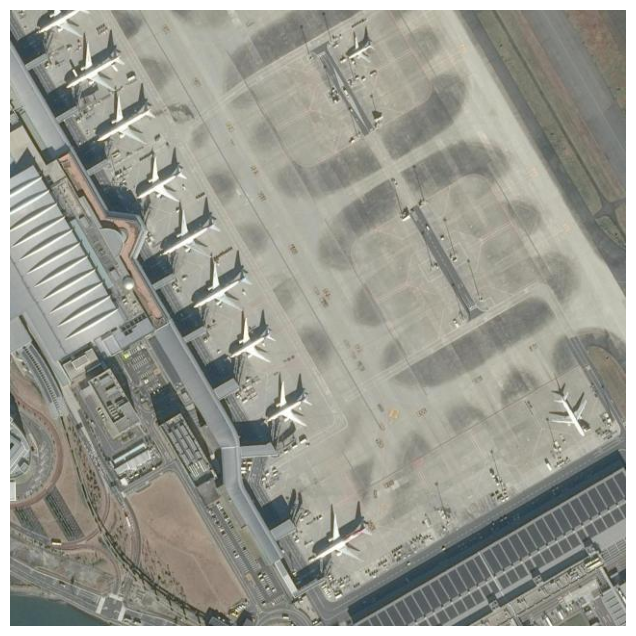

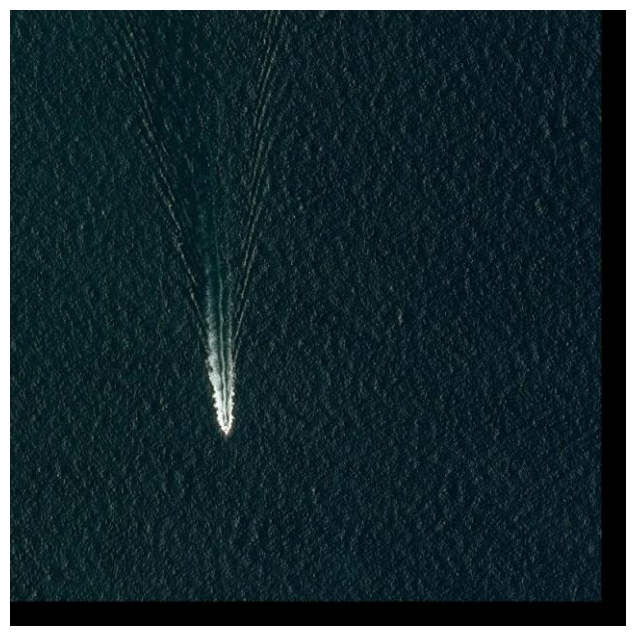

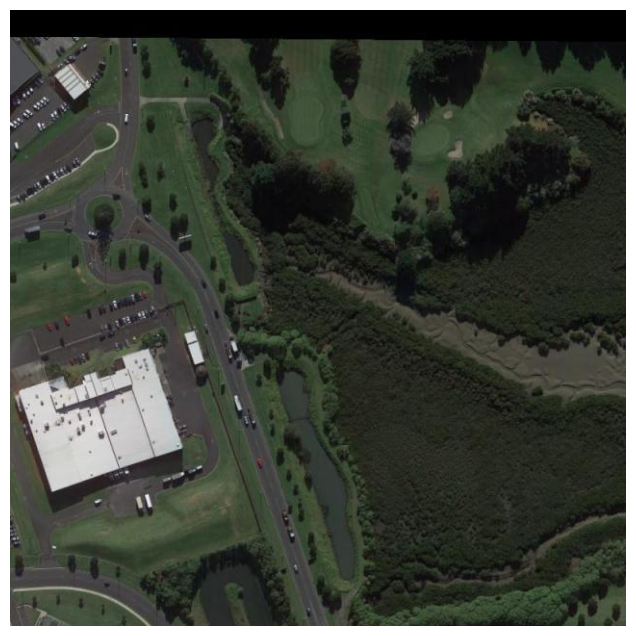

In [ ]:
# See some of those images

ph.show("SkyFusion_data/train/images/fc06c595-7905-46c3-91c0-daf56af0f926_1060_1060_jpg.rf.aed1374cb22ba3c0cbd7e1e1982c211a.jpg")
ph.show("SkyFusion_data/train/images/01cecb9b6_png_jpg.rf.a793b38cb22e4dd3b398cfaaf51f7ee7.jpg")
ph.show("SkyFusion_data/train/images/P2689__1-0__4200___0_png_jpg.rf.4dc96a40a2bca92078b26bb50652c98a.jpg")


As index for classes were:

'Aircraft': 1, 'ship': 2, 'vehicle': 3

We need to decrement them by 1 to follow YOLO class instructions, so we run the following code once

In [ ]:
'''
def adjust_class_indices(label_dir, adjustment=-1):
    """Adjust class indices in label files."""
    for root, _, files in os.walk(label_dir):
        for file in files:
            if file.endswith('.txt'):
                file_path = os.path.join(root, file)
                with open(file_path, 'r') as f:
                    lines = f.readlines()
                with open(file_path, 'w') as f:
                    for line in lines:
                        parts = line.strip().split()
                        parts[0] = str(int(parts[0]) + adjustment)  # Adjust class index
                        f.write(' '.join(parts) + '\n')

# Paths to your label directories
train_labels_dir = '/content/gdrive/MyDrive/Colab Notebooks/deep learning/final lab/SkyFusion_data/train/labels'
val_labels_dir = '/content/gdrive/MyDrive/Colab Notebooks/deep learning/final lab/SkyFusion_data/val/labels'
test_labels_dir = '/content/gdrive/MyDrive/Colab Notebooks/deep learning/final lab/SkyFusion_data/test/labels'

# Adjust class indices
adjust_class_indices(train_labels_dir)
adjust_class_indices(val_labels_dir)
adjust_class_indices(test_labels_dir)
'''

Now we're going to train a model on this custom dataset to be able to predict the objects in an image.

Before training with YOLOv8 you need to have an specific structure of the dataset.

```
dataset/
├── train/
│   ├── images/
│   └── labels/
├── val/
│   ├── images/
│   └── labels/
└── test/
    ├── images/
    └── labels/
```

## Create the Dataset Configuration YAML File

Create dataset_skyfusion.yaml to specify the dataset structure for YOLOv8 training.

In [ ]:
# Create dataset yaml file for YOLOv8
def create_dataset_yaml(main_path, train, val, test):
    content = f"""
# Dataset path
path: {main_path}

# Train/val/test sets
train: {train}
val: {val}
test: {test}

# Class Names
names:
  0: Aircraft
  1: ship
  2: vehicle
    """
    with open('dataset_skyfusion.yaml', 'w') as file:
        file.write(content)

create_dataset_yaml(PROJECT_DIR, 'SkyFusion_data/train/images', 'SkyFusion_data/val/images', 'SkyFusion_data/test/images')

In [ ]:
# Extract data from yaml file
id2class, class2id = ph.load_classes_from_yaml('dataset_skyfusion.yaml')
# See the class names found in the image
print(id2class)
print(class2id)

['Aircraft', 'ship', 'vehicle']
{'Aircraft': 0, 'ship': 1, 'vehicle': 2}


In [ ]:
os.environ['CUDA_LAUNCH_BLOCKING'] = "1"

## Train the YOLOv8 Model

In [ ]:

# Load the YOLOv8 model
model = YOLO('yolov8n.pt')

# Train the model
model.train(data='dataset_skyfusion.yaml', epochs=15)


New https://pypi.org/project/ultralytics/8.2.22 available 😃 Update with 'pip install -U ultralytics'
Ultralytics YOLOv8.1.0 🚀 Python-3.10.12 torch-2.3.0+cu121 CUDA:0 (Tesla T4, 15102MiB)
engine/trainer: task=detect, mode=train, model=yolov8n.pt, data=dataset_skyfusion.yaml, epochs=15, time=None, patience=50, batch=16, imgsz=640, save=True, save_period=-1, cache=False, device=None, workers=8, project=None, name=train3, exist_ok=False, pretrained=True, optimizer=auto, verbose=True, seed=0, deterministic=True, single_cls=False, rect=False, cos_lr=False, close_mosaic=10, resume=False, amp=True, fraction=1.0, profile=False, freeze=None, multi_scale=False, overlap_mask=True, mask_ratio=4, dropout=0.0, val=True, split=val, save_json=False, save_hybrid=False, conf=None, iou=0.7, max_det=300, half=False, dnn=False, plots=True, source=None, vid_stride=1, stream_buffer=False, visualize=False, augment=False, agnostic_nms=False, classes=None, retina_masks=False, embed=None, show=False, save_frames=

100%|██████████| 755k/755k [00:00<00:00, 37.8MB/s]


Overriding model.yaml nc=80 with nc=3

                   from  n    params  module                                       arguments                     
  0                  -1  1       464  ultralytics.nn.modules.conv.Conv             [3, 16, 3, 2]                 
  1                  -1  1      4672  ultralytics.nn.modules.conv.Conv             [16, 32, 3, 2]                
  2                  -1  1      7360  ultralytics.nn.modules.block.C2f             [32, 32, 1, True]             
  3                  -1  1     18560  ultralytics.nn.modules.conv.Conv             [32, 64, 3, 2]                
  4                  -1  2     49664  ultralytics.nn.modules.block.C2f             [64, 64, 2, True]             
  5                  -1  1     73984  ultralytics.nn.modules.conv.Conv             [64, 128, 3, 2]               
  6                  -1  2    197632  ultralytics.nn.modules.block.C2f             [128, 128, 2, True]           
  7                  -1  1    295424  ultralytics

/usr/local/lib/python3.10/dist-packages/torch/nn/modules/conv.py:456: UserWarning: Plan failed with a cudnnException: CUDNN_BACKEND_EXECUTION_PLAN_DESCRIPTOR: cudnnFinalize Descriptor Failed cudnn_status: CUDNN_STATUS_NOT_SUPPORTED (Triggered internally at ../aten/src/ATen/native/cudnn/Conv_v8.cpp:919.)
  return F.conv2d(input, weight, bias, self.stride,


WARNING ⚠️ NMS time limit 0.550s exceeded
AMP: checks passed ✅


train: Scanning /content/gdrive/MyDrive/Colab Notebooks/deep learning/final lab/SkyFusion_data/train/labels... 2094 images, 0 backgrounds, 0 corrupt: 100%|██████████| 2094/2094 [01:11<00:00, 29.17it/s] 


train: New cache created: /content/gdrive/MyDrive/Colab Notebooks/deep learning/final lab/SkyFusion_data/train/labels.cache
albumentations: Blur(p=0.01, blur_limit=(3, 7)), MedianBlur(p=0.01, blur_limit=(3, 7)), ToGray(p=0.01), CLAHE(p=0.01, clip_limit=(1, 4.0), tile_grid_size=(8, 8))


/usr/lib/python3.10/multiprocessing/popen_fork.py:66: RuntimeWarning: os.fork() was called. os.fork() is incompatible with multithreaded code, and JAX is multithreaded, so this will likely lead to a deadlock.
  self.pid = os.fork()
val: Scanning /content/gdrive/MyDrive/Colab Notebooks/deep learning/final lab/SkyFusion_data/val/labels... 449 images, 0 backgrounds, 0 corrupt: 100%|██████████| 449/449 [00:13<00:00, 33.53it/s]


val: New cache created: /content/gdrive/MyDrive/Colab Notebooks/deep learning/final lab/SkyFusion_data/val/labels.cache
Plotting labels to runs/detect/train3/labels.jpg... 
optimizer: 'optimizer=auto' found, ignoring 'lr0=0.01' and 'momentum=0.937' and determining best 'optimizer', 'lr0' and 'momentum' automatically... 
optimizer: AdamW(lr=0.001429, momentum=0.9) with parameter groups 57 weight(decay=0.0), 64 weight(decay=0.0005), 63 bias(decay=0.0)
15 epochs...

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       1/15      10.2G      2.055      2.173      1.134        280        640: 100%|██████████| 131/131 [01:48<00:00,  1.21it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95):   0%|          | 0/15 [00:00<?, ?it/s]/usr/local/lib/python3.10/dist-packages/torch/nn/modules/conv.py:456: UserWarning: Plan failed with a cudnnException: CUDNN_BACKEND_EXECUTION_PLAN_DESCRIPTOR: cudnnFinalize Descriptor Failed cudnn_status: CUDNN_STATUS_NOT_SUPPORTED (Triggered internally at ../aten/src/ATen/native/cudnn/Conv_v8.cpp:919.)
  return F.conv2d(input, weight, bias, self.stride,
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 15/15 [00:14<00:00,  1.01it/s]


                   all        449       8387      0.539      0.317       0.35      0.196

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       2/15      8.89G      1.819      1.348      1.042        272        640: 100%|██████████| 131/131 [01:35<00:00,  1.37it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 15/15 [00:12<00:00,  1.18it/s]


                   all        449       8387      0.523       0.37      0.391      0.203

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       3/15      8.98G      1.848      1.268       1.03        213        640: 100%|██████████| 131/131 [01:33<00:00,  1.40it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 15/15 [00:09<00:00,  1.54it/s]


                   all        449       8387      0.491      0.445      0.409      0.221

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       4/15      12.1G      1.772      1.132      1.015        266        640: 100%|██████████| 131/131 [01:33<00:00,  1.40it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 15/15 [00:11<00:00,  1.33it/s]


                   all        449       8387      0.511      0.504      0.443      0.241

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       5/15      7.98G      1.711      1.077      1.013        264        640: 100%|██████████| 131/131 [01:30<00:00,  1.44it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 15/15 [00:12<00:00,  1.17it/s]


                   all        449       8387      0.533      0.461       0.44      0.246
Closing dataloader mosaic
albumentations: Blur(p=0.01, blur_limit=(3, 7)), MedianBlur(p=0.01, blur_limit=(3, 7)), ToGray(p=0.01), CLAHE(p=0.01, clip_limit=(1, 4.0), tile_grid_size=(8, 8))


/usr/lib/python3.10/multiprocessing/popen_fork.py:66: RuntimeWarning: os.fork() was called. os.fork() is incompatible with multithreaded code, and JAX is multithreaded, so this will likely lead to a deadlock.
  self.pid = os.fork()



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       6/15      8.24G      1.722      1.075       1.02         63        640: 100%|██████████| 131/131 [01:30<00:00,  1.45it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 15/15 [00:12<00:00,  1.21it/s]


                   all        449       8387      0.525      0.465      0.438      0.236

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       7/15      10.6G      1.707      1.034       1.01        138        640: 100%|██████████| 131/131 [01:29<00:00,  1.46it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 15/15 [00:12<00:00,  1.18it/s]


                   all        449       8387      0.524      0.454      0.447       0.24

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       8/15      7.16G      1.701      1.008      1.013        391        640: 100%|██████████| 131/131 [01:22<00:00,  1.58it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 15/15 [00:09<00:00,  1.59it/s]


                   all        449       8387      0.503       0.48       0.44      0.247

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       9/15      9.51G      1.657     0.9732          1         50        640: 100%|██████████| 131/131 [01:22<00:00,  1.58it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 15/15 [00:08<00:00,  1.84it/s]


                   all        449       8387      0.528      0.487      0.468      0.257

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      10/15      8.85G      1.645     0.9418      1.003        129        640: 100%|██████████| 131/131 [01:24<00:00,  1.56it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 15/15 [00:12<00:00,  1.23it/s]


                   all        449       8387       0.56      0.521      0.491      0.265

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      11/15      9.15G      1.637     0.9305     0.9909        141        640: 100%|██████████| 131/131 [01:22<00:00,  1.58it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 15/15 [00:07<00:00,  1.95it/s]


                   all        449       8387      0.575      0.518      0.495      0.278

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      12/15      8.07G       1.58     0.8663     0.9861        167        640: 100%|██████████| 131/131 [01:23<00:00,  1.57it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 15/15 [00:12<00:00,  1.20it/s]

                   all        449       8387      0.554       0.52      0.496      0.274



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      13/15      9.19G      1.593     0.8518     0.9753        129        640: 100%|██████████| 131/131 [01:24<00:00,  1.55it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 15/15 [00:08<00:00,  1.74it/s]


                   all        449       8387      0.581      0.506      0.502      0.281

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      14/15       8.3G      1.579     0.8389     0.9708        139        640: 100%|██████████| 131/131 [01:24<00:00,  1.55it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 15/15 [00:10<00:00,  1.40it/s]

                   all        449       8387      0.616      0.529      0.516      0.287



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      15/15      8.56G      1.531     0.8049     0.9648        348        640: 100%|██████████| 131/131 [01:28<00:00,  1.48it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 15/15 [00:12<00:00,  1.18it/s]

                   all        449       8387      0.594      0.536      0.513      0.287



15 epochs completed in 0.425 hours.
Optimizer stripped from runs/detect/train3/weights/last.pt, 6.2MB
Optimizer stripped from runs/detect/train3/weights/best.pt, 6.2MB

Validating runs/detect/train3/weights/best.pt...
Ultralytics YOLOv8.1.0 🚀 Python-3.10.12 torch-2.3.0+cu121 CUDA:0 (Tesla T4, 15102MiB)
Model summary (fused): 168 layers, 3006233 parameters, 0 gradients, 8.1 GFLOPs


                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 15/15 [00:21<00:00,  1.43s/it]


                   all        449       8387      0.591      0.537      0.513      0.287
              Aircraft        449       1957      0.927      0.942       0.95      0.664
                  ship        449        288      0.459      0.354      0.327      0.119
               vehicle        449       6142      0.388      0.314      0.263     0.0774
Speed: 0.5ms preprocess, 11.4ms inference, 0.0ms loss, 6.0ms postprocess per image
Results saved to runs/detect/train3


ultralytics.utils.metrics.DetMetrics object with attributes:

ap_class_index: array([0, 1, 2])
box: ultralytics.utils.metrics.Metric object
confusion_matrix: <ultralytics.utils.metrics.ConfusionMatrix object at 0x7c5578173ca0>
curves: ['Precision-Recall(B)', 'F1-Confidence(B)', 'Precision-Confidence(B)', 'Recall-Confidence(B)']
curves_results: [[array([          0,    0.001001,    0.002002,    0.003003,    0.004004,    0.005005,    0.006006,    0.007007,    0.008008,    0.009009,     0.01001,    0.011011,    0.012012,    0.013013,    0.014014,    0.015015,    0.016016,    0.017017,    0.018018,    0.019019,     0.02002,    0.021021,    0.022022,    0.023023,
          0.024024,    0.025025,    0.026026,    0.027027,    0.028028,    0.029029,     0.03003,    0.031031,    0.032032,    0.033033,    0.034034,    0.035035,    0.036036,    0.037037,    0.038038,    0.039039,     0.04004,    0.041041,    0.042042,    0.043043,    0.044044,    0.045045,    0.046046,    0.047047,
          0.04

## Visualize Training Results

In [ ]:
# Get the folder where the last training info has been saved
tr_folder = sorted([name for name in os.listdir('runs/detect') if os.path.isdir(os.path.join('runs/detect', name)) and name.startswith('train3')])[-1]
print(tr_folder)

# See the metrics
%load_ext tensorboard
%tensorboard --logdir {'runs/detect/' + tr_folder}


train3
The tensorboard extension is already loaded. To reload it, use:
  %reload_ext tensorboard


<IPython.core.display.Javascript object>

## Evaluate the Model on Test Data


0: 640x640 18 Aircrafts, 1: 640x640 (no detections), 2: 640x640 1 ship, 3: 640x640 16 Aircrafts, 4: 640x640 1 ship, 5: 640x640 2 ships, 6: 640x640 8 Aircrafts, 7: 640x640 7 Aircrafts, 8: 640x640 7 Aircrafts, 9: 640x640 14 Aircrafts, 10: 640x640 (no detections), 11: 640x640 1 ship, 12: 640x640 (no detections), 122.0ms
Speed: 15.0ms preprocess, 9.4ms inference, 1.1ms postprocess per image at shape (1, 3, 640, 640)
Results saved to runs/detect/predict3


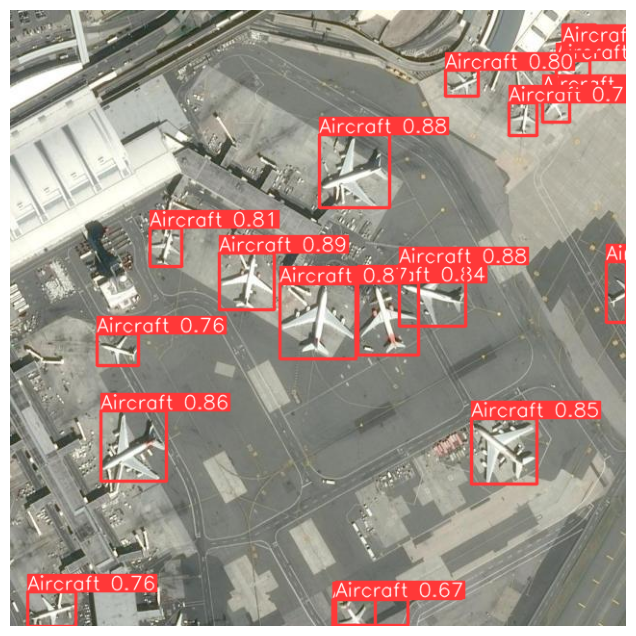

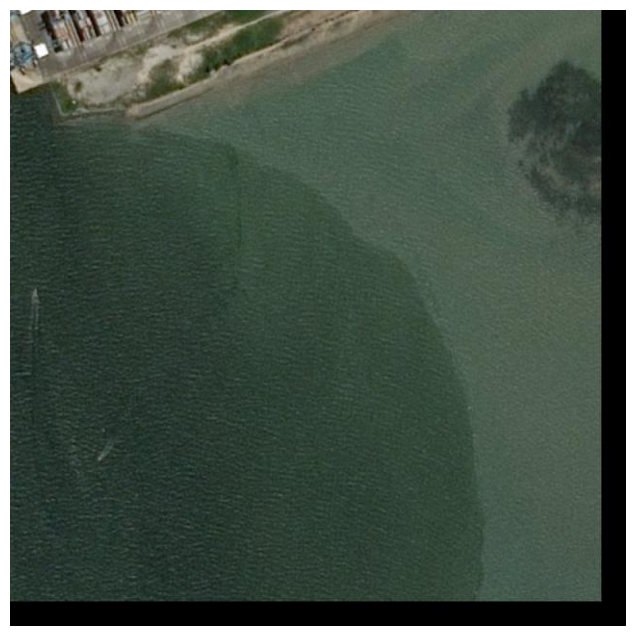

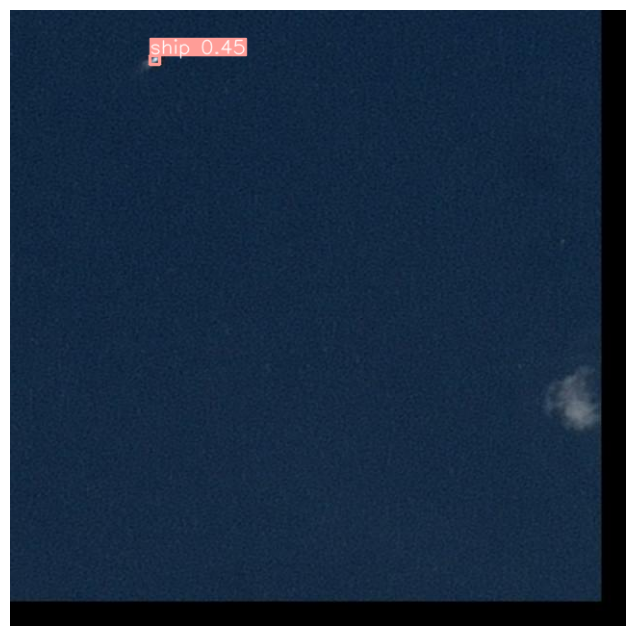

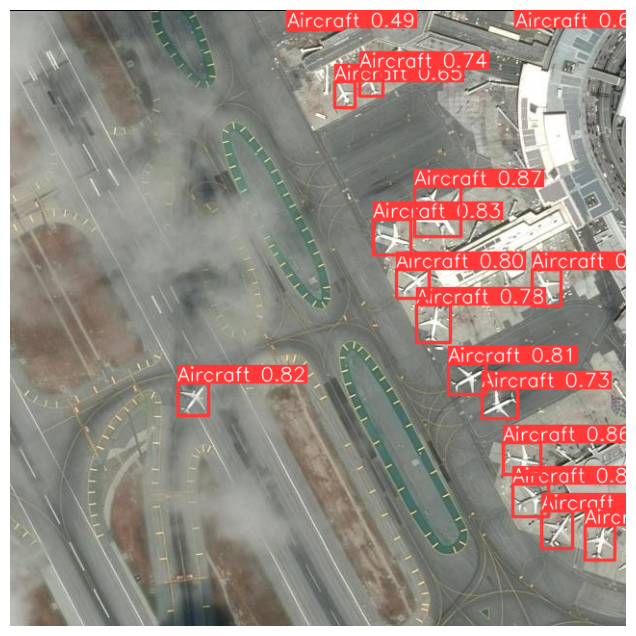

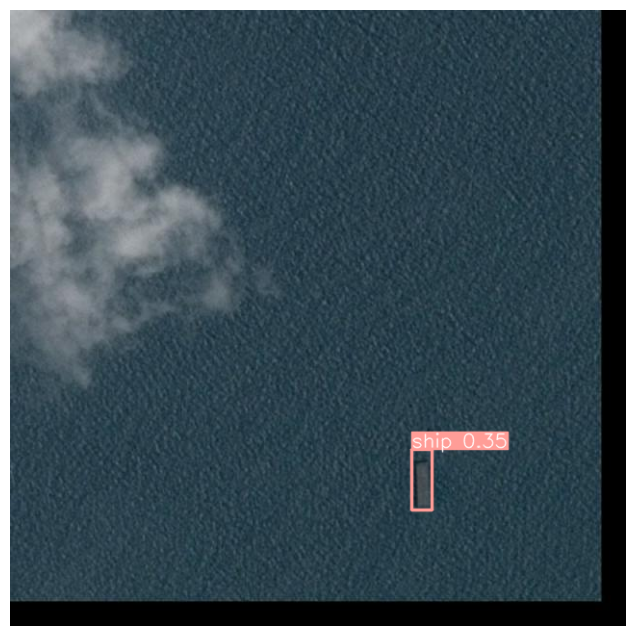

...

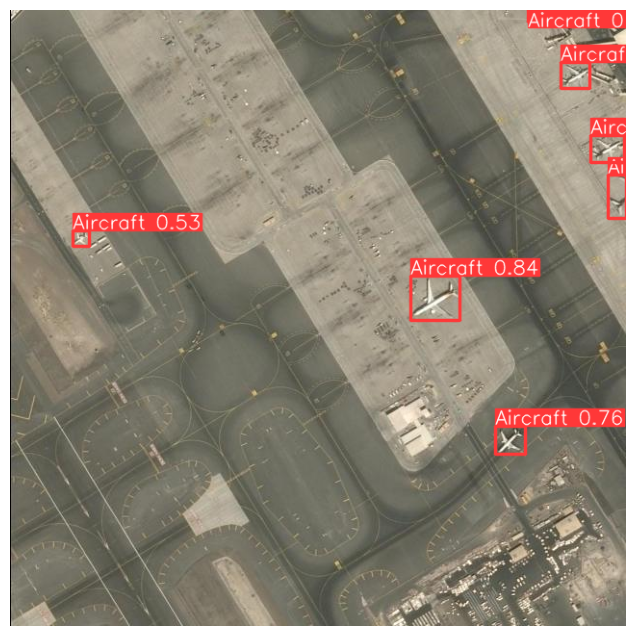

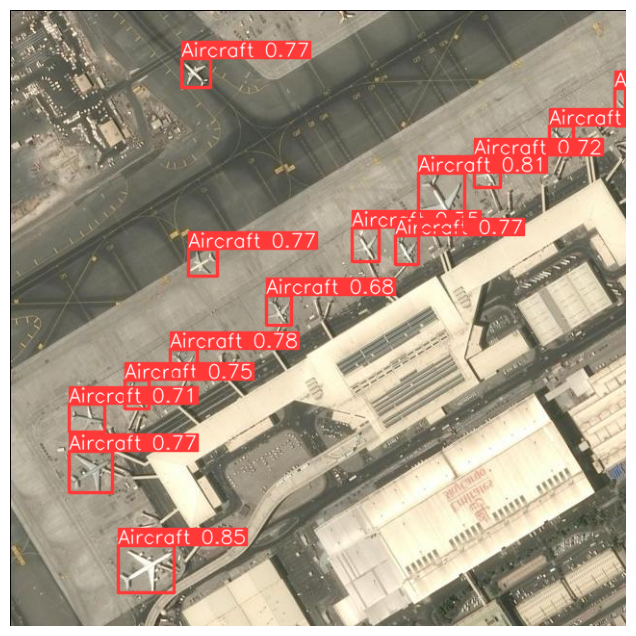

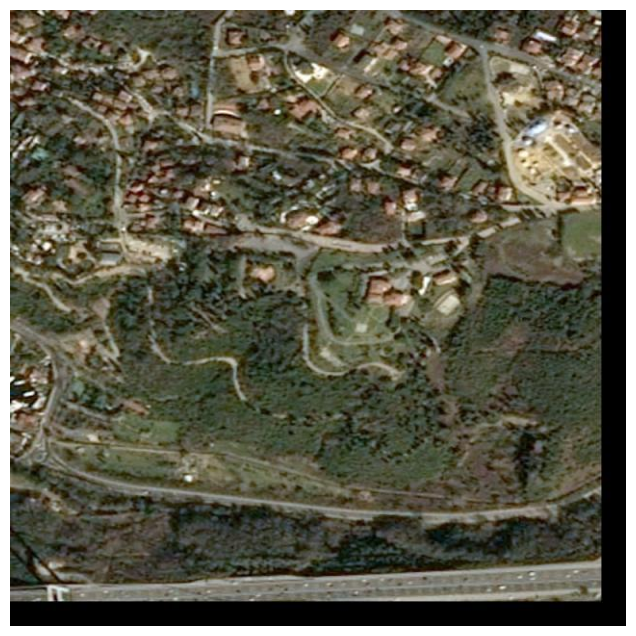

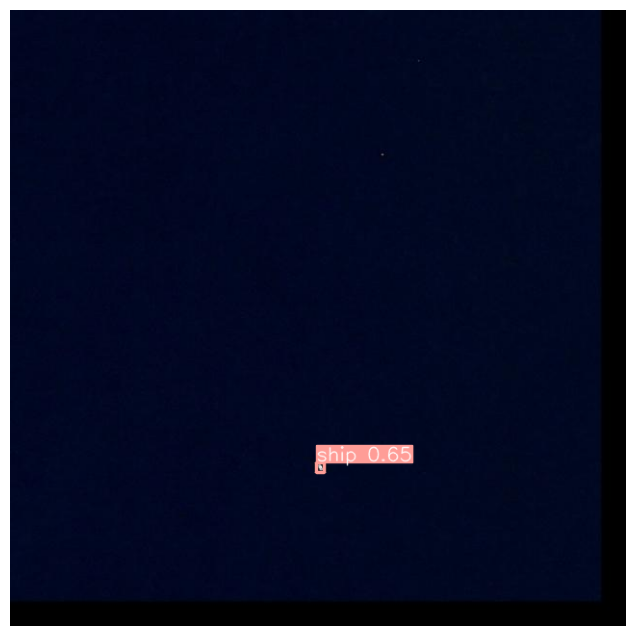

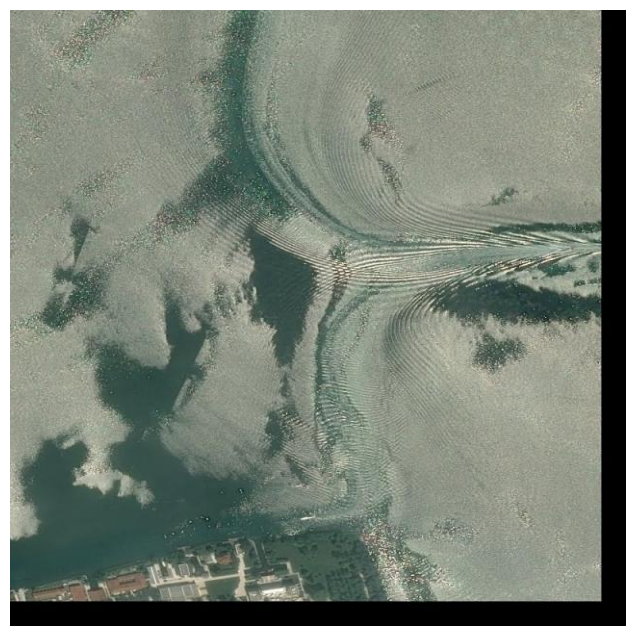

Ultralytics YOLOv8.1.0 🚀 Python-3.10.12 torch-2.3.0+cu121 CUDA:0 (Tesla T4, 15102MiB)


val: Scanning /content/gdrive/.shortcut-targets-by-id/1byU-8-aKvjgELckMiC_W2mRoca0HRiyP/Colab Notebooks/deep learning/final lab/SkyFusion_data/test/labels... 449 images, 0 backgrounds, 0 corrupt: 100%|██████████| 449/449 [01:48<00:00,  4.14it/s]


val: New cache created: /content/gdrive/.shortcut-targets-by-id/1byU-8-aKvjgELckMiC_W2mRoca0HRiyP/Colab Notebooks/deep learning/final lab/SkyFusion_data/test/labels.cache


/usr/lib/python3.10/multiprocessing/popen_fork.py:66: RuntimeWarning: os.fork() was called. os.fork() is incompatible with multithreaded code, and JAX is multithreaded, so this will likely lead to a deadlock.
  self.pid = os.fork()
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 29/29 [00:48<00:00,  1.66s/it]


                   all        449      11751      0.568      0.502      0.472      0.272
              Aircraft        449       1968      0.906      0.915      0.927      0.659
                  ship        449        406      0.405      0.283      0.243     0.0853
               vehicle        449       9377      0.393      0.306      0.247     0.0729
Speed: 1.9ms preprocess, 12.6ms inference, 0.1ms loss, 11.2ms postprocess per image
Results saved to runs/detect/val2
0.272437635091441
0.4723126403849512
0.287808166838166
[    0.65909    0.085319    0.072901]


In [ ]:
# Get the best model
model = YOLO(f'runs/detect/{tr_folder}/weights/best.pt')

# Get some test images
path = 'SkyFusion_data/test/images'
test_images = sorted(ph.list_files_in_folder(path, absolute=True))[15:30]

# Calculate inference
results = model(source=test_images, show=False, conf=0.3, save=True)

# Show some results
for k in range(len(results)):
    ph.show(results[k])

# Test the model with the test dataset
metrics = model.val(split='test')

print(metrics.box.map)    # map50-95
print(metrics.box.map50)  # map50
print(metrics.box.map75)  # map75
print(metrics.box.maps)   # a list contains map50-95 of each category


## Implement K-Fold Cross Validation

Once you've been able to do a training with your custom dataset, it has arrived the moment to go one step further.

You may have already realized that the strategy of configuring a folder structure with 'train', 'val' and 'test' is quite rigid in the sense that it is not agile to change files from one folder to another.

There must be a more agile way of managing the files that will be part of each set, and in fact there is. Find out!

In this section you have to set up a training based on 8-fold cross validation, do this training and report the average mAP50 metric. You should do this using the files intended for 'train' and 'val'.

Naturally, the management of the files that will make up each set has to be dynamic, and it is not acceptable for these files to change their location on disk.

Note: It's enough that you train for 5 epochs.

In [ ]:
from sklearn.model_selection import KFold

In [ ]:
# Load a pretrained YOLOv8n detection model
model = YOLO('yolov8n.pt')

In [ ]:
def kfold_cv(length, k, test_percent):
    """
    Generates indices for test data and k-fold cross validation on a dataset.

    Args:
    length (int): Total number of images in the dataset.
    k (int): Number of folds for k-fold cross validation.
    test_percent (float): Percentage of the dataset to be used for testing.

    Returns:
    tuple:
        - test_ids (list): A list of indices for test data.
        - kfold_generator (generator): A generator that yields training and
            validation indices for each fold.
    """
    # Calculate the number of test images
    num_test_images = int(length * test_percent / 100)

    # Randomly select test indices
    all_indices = np.arange(length)
    np.random.shuffle(all_indices)
    test_ids = list(all_indices[:num_test_images])

    # Remaining indices for k-fold
    remaining_indices = all_indices[num_test_images:]

    # K-Fold Cross Validation
    kf = KFold(n_splits=k)
    kfold_generator = ((list(remaining_indices[train_index]),
                        list(remaining_indices[val_index])) for train_index,
                        val_index in kf.split(remaining_indices))

    return test_ids, kfold_generator

In [ ]:
def select_strings(strings, indices, pre='', post=''):
    """
    Selects and returns strings from a list based on a list of indices.

    Args:
    strings (list of str): The list of strings.
    indices (list of int): The list of indices to select strings.
    pre (string): String to add before the indexed string.
    post (string): String to add after the indexed string.

    Returns:
    list of str: The list of selected strings.

    Example:
    select_strings(['John', 'Tom', 'Jack', 'Sam'], [0, 3], pre='Hello ')
    >>> ['Hello John', 'Hello Sam']
    """
    return [pre + strings[i] + post for i in indices if i < len(strings)]

In [ ]:
def create_text_file(strings, folder_path=None, file_name="output.txt"):
    """
    Creates a text file with each string from the list on a separate line
    in UTF-8 format.

    Args:
    strings (list of str): The list of strings to be written to the file.
    folder_path (str, optional): The path to the folder where the file will
        be saved. If not provided, the file is saved in the current directory.
    file_name (str, optional): The name of the file to be created. Defaults
        to 'output.txt'.
    """
    # If a folder path is provided, use it; otherwise, use the current
    # directory
    if folder_path:
        full_path = os.path.join(folder_path, file_name)
    else:
        full_path = file_name

    # Writing the strings to the file in UTF-8 format
    with open(full_path, 'w', encoding='utf-8') as file:
        for string in strings:
            file.write(string + '\n')


In [ ]:
# Before executing next cell make sure you have your file
# 'dataset_skyfusion.yaml' properly configured. Specifically, it must
# point to the files `test.txt`, `val.txt` and `train.txt`.

# Get the dataset folder
dataset_path = os.path.join(PROJECT_DIR, 'SkyFusion_data')

# List all image files
all_files = [f for f in ph.list_files_in_folder(dataset_path,
    absolute=True, recursivity=True) if str(f).endswith('.jpg')]

# Select parameters in k-fold cross validation
k = 8
test_percent = 18  # Percentage of data for testing
test_ids, kfold_gen = kfold_cv(len(all_files), k, test_percent)

# Get paths list for testing and create text file
test_paths = select_strings(all_files, test_ids)
create_text_file(test_paths, dataset_path, 'test.txt')

print(all_files)

['/content/gdrive/.shortcut-targets-by-id/1byU-8-aKvjgELckMiC_W2mRoca0HRiyP/Colab Notebooks/deep learning/final lab/SkyFusion_data/train/images/1ccc35901_png_jpg.rf.80f09fc7bd2a8eec44d9fec777cf48cc.jpg', '/content/gdrive/.shortcut-targets-by-id/1byU-8-aKvjgELckMiC_W2mRoca0HRiyP/Colab Notebooks/deep learning/final lab/SkyFusion_data/train/images/P2160__1-0__0___600_png_jpg.rf.7fcbc900b39c175a25ae4f81d7d489d8.jpg', '/content/gdrive/.shortcut-targets-by-id/1byU-8-aKvjgELckMiC_W2mRoca0HRiyP/Colab Notebooks/deep learning/final lab/SkyFusion_data/train/images/01ed38a14_png_jpg.rf.ee99a2f36cc6bcdcabf0df5ae1287eba.jpg', '/content/gdrive/.shortcut-targets-by-id/1byU-8-aKvjgELckMiC_W2mRoca0HRiyP/Colab Notebooks/deep learning/final lab/SkyFusion_data/train/images/4a309af81_png_jpg.rf.826ad0528d8f27f7402b0a2503d0eaf4.jpg', '/content/gdrive/.shortcut-targets-by-id/1byU-8-aKvjgELckMiC_W2mRoca0HRiyP/Colab Notebooks/deep learning/final lab/SkyFusion_data/train/images/P2173__1-0__3000___1200_png_jpg.rf

In [ ]:
# Train the models
metric = []
for train_ids, val_ids in kfold_gen:
    # Get training and validation images paths
    train_paths = select_strings(all_files, train_ids)
    val_paths = select_strings(all_files, val_ids)

    # Create text files with the lists of images paths
    create_text_file(train_paths, dataset_path, 'train.txt')
    create_text_file(val_paths, dataset_path, 'val.txt')

    # Train the model
    model.train(data='dataset_skyfusion.yaml', epochs=5, resume=False)
    metric.append(model.metrics.results_dict['metrics/mAP50(B)'])

New https://pypi.org/project/ultralytics/8.2.22 available 😃 Update with 'pip install -U ultralytics'
Ultralytics YOLOv8.1.0 🚀 Python-3.10.12 torch-2.3.0+cu121 CUDA:0 (Tesla T4, 15102MiB)
engine/trainer: task=detect, mode=train, model=yolov8n.pt, data=dataset_skyfusion.yaml, epochs=5, time=None, patience=50, batch=16, imgsz=640, save=True, save_period=-1, cache=False, device=None, workers=8, project=None, name=train5, exist_ok=False, pretrained=True, optimizer=auto, verbose=True, seed=0, deterministic=True, single_cls=False, rect=False, cos_lr=False, close_mosaic=10, resume=False, amp=True, fraction=1.0, profile=False, freeze=None, multi_scale=False, overlap_mask=True, mask_ratio=4, dropout=0.0, val=True, split=val, save_json=False, save_hybrid=False, conf=None, iou=0.7, max_det=300, half=False, dnn=False, plots=True, source=None, vid_stride=1, stream_buffer=False, visualize=False, augment=False, agnostic_nms=False, classes=None, retina_masks=False, embed=None, show=False, save_frames=F

100%|██████████| 755k/755k [00:00<00:00, 14.4MB/s]


Overriding model.yaml nc=80 with nc=3

                   from  n    params  module                                       arguments                     
  0                  -1  1       464  ultralytics.nn.modules.conv.Conv             [3, 16, 3, 2]                 
  1                  -1  1      4672  ultralytics.nn.modules.conv.Conv             [16, 32, 3, 2]                
  2                  -1  1      7360  ultralytics.nn.modules.block.C2f             [32, 32, 1, True]             
  3                  -1  1     18560  ultralytics.nn.modules.conv.Conv             [32, 64, 3, 2]                
  4                  -1  2     49664  ultralytics.nn.modules.block.C2f             [64, 64, 2, True]             
  5                  -1  1     73984  ultralytics.nn.modules.conv.Conv             [64, 128, 3, 2]               
  6                  -1  2    197632  ultralytics.nn.modules.block.C2f             [128, 128, 2, True]           
  7                  -1  1    295424  ultralytics

/usr/local/lib/python3.10/dist-packages/torch/nn/modules/conv.py:456: UserWarning: Plan failed with a cudnnException: CUDNN_BACKEND_EXECUTION_PLAN_DESCRIPTOR: cudnnFinalize Descriptor Failed cudnn_status: CUDNN_STATUS_NOT_SUPPORTED (Triggered internally at ../aten/src/ATen/native/cudnn/Conv_v8.cpp:919.)
  return F.conv2d(input, weight, bias, self.stride,


WARNING ⚠️ NMS time limit 0.550s exceeded
AMP: checks passed ✅


train: Scanning /content/gdrive/.shortcut-targets-by-id/1byU-8-aKvjgELckMiC_W2mRoca0HRiyP/Colab Notebooks/deep learning/final lab/SkyFusion_data/train/labels... 8 images, 192 backgrounds, 0 corrupt: 100%|██████████| 200/200 [00:05<00:00, 39.04it/s]


train: New cache created: /content/gdrive/.shortcut-targets-by-id/1byU-8-aKvjgELckMiC_W2mRoca0HRiyP/Colab Notebooks/deep learning/final lab/SkyFusion_data/train/labels.cache
albumentations: Blur(p=0.01, blur_limit=(3, 7)), MedianBlur(p=0.01, blur_limit=(3, 7)), ToGray(p=0.01), CLAHE(p=0.01, clip_limit=(1, 4.0), tile_grid_size=(8, 8))


/usr/lib/python3.10/multiprocessing/popen_fork.py:66: RuntimeWarning: os.fork() was called. os.fork() is incompatible with multithreaded code, and JAX is multithreaded, so this will likely lead to a deadlock.
  self.pid = os.fork()
val: Scanning /content/gdrive/.shortcut-targets-by-id/1byU-8-aKvjgELckMiC_W2mRoca0HRiyP/Colab Notebooks/deep learning/final lab/SkyFusion_data/val/labels... 196 images, 102 backgrounds, 0 corrupt: 100%|██████████| 298/298 [00:49<00:00,  5.99it/s]


val: New cache created: /content/gdrive/.shortcut-targets-by-id/1byU-8-aKvjgELckMiC_W2mRoca0HRiyP/Colab Notebooks/deep learning/final lab/SkyFusion_data/val/labels.cache
Plotting labels to runs/detect/train5/labels.jpg... 
optimizer: 'optimizer=auto' found, ignoring 'lr0=0.01' and 'momentum=0.937' and determining best 'optimizer', 'lr0' and 'momentum' automatically... 
optimizer: AdamW(lr=0.001429, momentum=0.9) with parameter groups 57 weight(decay=0.0), 64 weight(decay=0.0005), 63 bias(decay=0.0)
5 epochs...

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


        1/5      2.46G      1.158      79.88     0.6084          0        640: 100%|██████████| 13/13 [00:07<00:00,  1.66it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95):   0%|          | 0/10 [00:00<?, ?it/s]/usr/local/lib/python3.10/dist-packages/torch/nn/modules/conv.py:456: UserWarning: Plan failed with a cudnnException: CUDNN_BACKEND_EXECUTION_PLAN_DESCRIPTOR: cudnnFinalize Descriptor Failed cudnn_status: CUDNN_STATUS_NOT_SUPPORTED (Triggered internally at ../aten/src/ATen/native/cudnn/Conv_v8.cpp:919.)
  return F.conv2d(input, weight, bias, self.stride,
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 10/10 [00:07<00:00,  1.34it/s]

                   all        298       2890   0.000115    0.00399    5.9e-05   2.15e-05



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


        2/5      2.29G     0.9862      73.67     0.5182          0        640: 100%|██████████| 13/13 [00:03<00:00,  4.14it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 10/10 [00:05<00:00,  1.67it/s]


                   all        298       2890     0.0002     0.0069   0.000103   4.72e-05

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


        3/5      2.34G      1.307       48.2     0.8196          0        640: 100%|██████████| 13/13 [00:04<00:00,  2.83it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 10/10 [00:04<00:00,  2.43it/s]


                   all        298       2890   3.03e-05   0.000726   1.53e-05   5.33e-06

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


        4/5      2.41G      1.322      43.61     0.7266          0        640: 100%|██████████| 13/13 [00:03<00:00,  3.68it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 10/10 [00:06<00:00,  1.43it/s]


                   all        298       2890   4.79e-05    0.00145   2.41e-05   3.61e-06

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


        5/5      2.39G      1.227      72.51     0.5235          0        640: 100%|██████████| 13/13 [00:03<00:00,  3.72it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 10/10 [00:03<00:00,  2.65it/s]


                   all        298       2890    7.5e-05    0.00254   3.82e-05   1.38e-05

5 epochs completed in 0.017 hours.
Optimizer stripped from runs/detect/train5/weights/last.pt, 6.2MB
Optimizer stripped from runs/detect/train5/weights/best.pt, 6.2MB

Validating runs/detect/train5/weights/best.pt...
Ultralytics YOLOv8.1.0 🚀 Python-3.10.12 torch-2.3.0+cu121 CUDA:0 (Tesla T4, 15102MiB)
Model summary (fused): 168 layers, 3006233 parameters, 0 gradients, 8.1 GFLOPs


                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 10/10 [00:12<00:00,  1.27s/it]


                   all        298       2890     0.0002     0.0069   0.000103   4.72e-05
              Aircraft        298        918   0.000599     0.0207   0.000308   0.000142
                  ship        298         97          0          0          0          0
               vehicle        298       1875          0          0          0          0
Speed: 0.6ms preprocess, 3.4ms inference, 0.1ms loss, 22.2ms postprocess per image
Results saved to runs/detect/train5
New https://pypi.org/project/ultralytics/8.2.22 available 😃 Update with 'pip install -U ultralytics'
Ultralytics YOLOv8.1.0 🚀 Python-3.10.12 torch-2.3.0+cu121 CUDA:0 (Tesla T4, 15102MiB)
engine/trainer: task=detect, mode=train, model=yolov8n.pt, data=dataset_skyfusion.yaml, epochs=5, time=None, patience=50, batch=16, imgsz=640, save=True, save_period=-1, cache=False, device=None, workers=8, project=None, name=train52, exist_ok=False, pretrained=True, optimizer=auto, verbose=True, seed=0, deterministic=True, single_cls=F

train: Scanning /content/gdrive/.shortcut-targets-by-id/1byU-8-aKvjgELckMiC_W2mRoca0HRiyP/Colab Notebooks/deep learning/final lab/SkyFusion_data/train/labels.cache... 8 images, 192 backgrounds, 0 corrupt: 100%|██████████| 200/200 [00:00<?, ?it/s]

albumentations: Blur(p=0.01, blur_limit=(3, 7)), MedianBlur(p=0.01, blur_limit=(3, 7)), ToGray(p=0.01), CLAHE(p=0.01, clip_limit=(1, 4.0), tile_grid_size=(8, 8))



/usr/lib/python3.10/multiprocessing/popen_fork.py:66: RuntimeWarning: os.fork() was called. os.fork() is incompatible with multithreaded code, and JAX is multithreaded, so this will likely lead to a deadlock.
  self.pid = os.fork()
val: Scanning /content/gdrive/.shortcut-targets-by-id/1byU-8-aKvjgELckMiC_W2mRoca0HRiyP/Colab Notebooks/deep learning/final lab/SkyFusion_data/val/labels.cache... 196 images, 102 backgrounds, 0 corrupt: 100%|██████████| 298/298 [00:00<?, ?it/s]


Plotting labels to runs/detect/train52/labels.jpg... 
optimizer: 'optimizer=auto' found, ignoring 'lr0=0.01' and 'momentum=0.937' and determining best 'optimizer', 'lr0' and 'momentum' automatically... 
optimizer: AdamW(lr=0.001429, momentum=0.9) with parameter groups 57 weight(decay=0.0), 64 weight(decay=0.0005), 63 bias(decay=0.0)
5 epochs...

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


        1/5       2.6G     0.8634      68.78     0.4479          0        640: 100%|██████████| 13/13 [00:07<00:00,  1.70it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 10/10 [00:04<00:00,  2.37it/s]

                   all        298       2890    9.1e-05     0.0029   4.61e-05   1.95e-05



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


        2/5      2.34G     0.7986      64.93     0.4174          0        640: 100%|██████████| 13/13 [00:13<00:00,  1.05s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 10/10 [00:04<00:00,  2.32it/s]


                   all        298       2890   4.54e-05    0.00145   2.29e-05   9.76e-06

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


        3/5      2.34G      1.585      44.49     0.9676          0        640: 100%|██████████| 13/13 [00:05<00:00,  2.39it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 10/10 [00:06<00:00,  1.46it/s]


                   all        298       2890   9.79e-06   0.000363   5.01e-06   5.01e-07

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


        4/5      2.42G      1.377      46.16     0.8019          0        640: 100%|██████████| 13/13 [00:03<00:00,  4.09it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 10/10 [00:04<00:00,  2.46it/s]


                   all        298       2890   0.000131    0.00472   7.75e-05    4.6e-05

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


        5/5      2.39G      1.369      73.51     0.5602          0        640: 100%|██████████| 13/13 [00:05<00:00,  2.42it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 10/10 [00:06<00:00,  1.49it/s]

                   all        298       2890   0.000365     0.0134   0.000662   0.000371



5 epochs completed in 0.020 hours.
Optimizer stripped from runs/detect/train52/weights/last.pt, 6.2MB
Optimizer stripped from runs/detect/train52/weights/best.pt, 6.2MB

Validating runs/detect/train52/weights/best.pt...
Ultralytics YOLOv8.1.0 🚀 Python-3.10.12 torch-2.3.0+cu121 CUDA:0 (Tesla T4, 15102MiB)
Model summary (fused): 168 layers, 3006233 parameters, 0 gradients, 8.1 GFLOPs


                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 10/10 [00:10<00:00,  1.03s/it]


                   all        298       2890   0.000375     0.0138   0.000654   0.000365
              Aircraft        298        918    0.00112     0.0414    0.00196    0.00109
                  ship        298         97          0          0          0          0
               vehicle        298       1875          0          0          0          0
Speed: 0.4ms preprocess, 4.1ms inference, 0.1ms loss, 8.5ms postprocess per image
Results saved to runs/detect/train52
New https://pypi.org/project/ultralytics/8.2.22 available 😃 Update with 'pip install -U ultralytics'
Ultralytics YOLOv8.1.0 🚀 Python-3.10.12 torch-2.3.0+cu121 CUDA:0 (Tesla T4, 15102MiB)
engine/trainer: task=detect, mode=train, model=yolov8n.pt, data=dataset_skyfusion.yaml, epochs=5, time=None, patience=50, batch=16, imgsz=640, save=True, save_period=-1, cache=False, device=None, workers=8, project=None, name=train522, exist_ok=False, pretrained=True, optimizer=auto, verbose=True, seed=0, deterministic=True, single_cls=

train: Scanning /content/gdrive/.shortcut-targets-by-id/1byU-8-aKvjgELckMiC_W2mRoca0HRiyP/Colab Notebooks/deep learning/final lab/SkyFusion_data/train/labels... 18 images, 182 backgrounds, 0 corrupt: 100%|██████████| 200/200 [00:03<00:00, 58.69it/s]


train: New cache created: /content/gdrive/.shortcut-targets-by-id/1byU-8-aKvjgELckMiC_W2mRoca0HRiyP/Colab Notebooks/deep learning/final lab/SkyFusion_data/train/labels.cache
albumentations: Blur(p=0.01, blur_limit=(3, 7)), MedianBlur(p=0.01, blur_limit=(3, 7)), ToGray(p=0.01), CLAHE(p=0.01, clip_limit=(1, 4.0), tile_grid_size=(8, 8))


/usr/lib/python3.10/multiprocessing/popen_fork.py:66: RuntimeWarning: os.fork() was called. os.fork() is incompatible with multithreaded code, and JAX is multithreaded, so this will likely lead to a deadlock.
  self.pid = os.fork()
val: Scanning /content/gdrive/.shortcut-targets-by-id/1byU-8-aKvjgELckMiC_W2mRoca0HRiyP/Colab Notebooks/deep learning/final lab/SkyFusion_data/val/labels.cache... 196 images, 102 backgrounds, 0 corrupt: 100%|██████████| 298/298 [00:00<?, ?it/s]


Plotting labels to runs/detect/train522/labels.jpg... 
optimizer: 'optimizer=auto' found, ignoring 'lr0=0.01' and 'momentum=0.937' and determining best 'optimizer', 'lr0' and 'momentum' automatically... 
optimizer: AdamW(lr=0.001429, momentum=0.9) with parameter groups 57 weight(decay=0.0), 64 weight(decay=0.0005), 63 bias(decay=0.0)
5 epochs...

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


        1/5      2.53G      1.221      40.91     0.8085          0        640: 100%|██████████| 13/13 [00:08<00:00,  1.62it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 10/10 [00:03<00:00,  2.80it/s]


                   all        298       2890      0.118     0.0327      0.025     0.0112

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


        2/5      2.23G      1.834       61.6     0.8929          0        640: 100%|██████████| 13/13 [00:05<00:00,  2.41it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 10/10 [00:07<00:00,  1.35it/s]


                   all        298       2890      0.209     0.0589     0.0791     0.0356

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


        3/5      2.19G      1.823      53.09     0.8307          1        640: 100%|██████████| 13/13 [00:03<00:00,  4.06it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 10/10 [00:03<00:00,  2.65it/s]


                   all        298       2890    1.4e-05   0.000726   7.15e-06   2.86e-06

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


        4/5      2.36G      1.714      28.88     0.9783          1        640: 100%|██████████| 13/13 [00:05<00:00,  2.29it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 10/10 [00:06<00:00,  1.49it/s]

                   all        298       2890   8.54e-06   0.000363    4.4e-06   8.79e-07



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


        5/5      2.31G      1.517      40.64     0.8688          5        640: 100%|██████████| 13/13 [00:03<00:00,  4.05it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 10/10 [00:03<00:00,  2.51it/s]


                   all        298       2890   8.45e-06   0.000363   4.27e-06   8.55e-07

5 epochs completed in 0.017 hours.
Optimizer stripped from runs/detect/train522/weights/last.pt, 6.2MB
Optimizer stripped from runs/detect/train522/weights/best.pt, 6.2MB

Validating runs/detect/train522/weights/best.pt...
Ultralytics YOLOv8.1.0 🚀 Python-3.10.12 torch-2.3.0+cu121 CUDA:0 (Tesla T4, 15102MiB)
Model summary (fused): 168 layers, 3006233 parameters, 0 gradients, 8.1 GFLOPs


                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 10/10 [00:14<00:00,  1.41s/it]


                   all        298       2890      0.209     0.0592     0.0789     0.0357
              Aircraft        298        918      0.626      0.178      0.237      0.107
                  ship        298         97          0          0          0          0
               vehicle        298       1875          0          0          0          0
Speed: 0.6ms preprocess, 5.4ms inference, 0.0ms loss, 16.3ms postprocess per image
Results saved to runs/detect/train522
New https://pypi.org/project/ultralytics/8.2.22 available 😃 Update with 'pip install -U ultralytics'
Ultralytics YOLOv8.1.0 🚀 Python-3.10.12 torch-2.3.0+cu121 CUDA:0 (Tesla T4, 15102MiB)
engine/trainer: task=detect, mode=train, model=yolov8n.pt, data=dataset_skyfusion.yaml, epochs=5, time=None, patience=50, batch=16, imgsz=640, save=True, save_period=-1, cache=False, device=None, workers=8, project=None, name=train5222, exist_ok=False, pretrained=True, optimizer=auto, verbose=True, seed=0, deterministic=True, single_c

train: Scanning /content/gdrive/.shortcut-targets-by-id/1byU-8-aKvjgELckMiC_W2mRoca0HRiyP/Colab Notebooks/deep learning/final lab/SkyFusion_data/train/labels... 24 images, 218 backgrounds, 0 corrupt: 100%|██████████| 242/242 [00:04<00:00, 49.16it/s]


train: New cache created: /content/gdrive/.shortcut-targets-by-id/1byU-8-aKvjgELckMiC_W2mRoca0HRiyP/Colab Notebooks/deep learning/final lab/SkyFusion_data/train/labels.cache
albumentations: Blur(p=0.01, blur_limit=(3, 7)), MedianBlur(p=0.01, blur_limit=(3, 7)), ToGray(p=0.01), CLAHE(p=0.01, clip_limit=(1, 4.0), tile_grid_size=(8, 8))


/usr/lib/python3.10/multiprocessing/popen_fork.py:66: RuntimeWarning: os.fork() was called. os.fork() is incompatible with multithreaded code, and JAX is multithreaded, so this will likely lead to a deadlock.
  self.pid = os.fork()
val: Scanning /content/gdrive/.shortcut-targets-by-id/1byU-8-aKvjgELckMiC_W2mRoca0HRiyP/Colab Notebooks/deep learning/final lab/SkyFusion_data/val/labels.cache... 196 images, 102 backgrounds, 0 corrupt: 100%|██████████| 298/298 [00:00<?, ?it/s]


Plotting labels to runs/detect/train5222/labels.jpg... 
optimizer: 'optimizer=auto' found, ignoring 'lr0=0.01' and 'momentum=0.937' and determining best 'optimizer', 'lr0' and 'momentum' automatically... 
optimizer: AdamW(lr=0.001429, momentum=0.9) with parameter groups 57 weight(decay=0.0), 64 weight(decay=0.0005), 63 bias(decay=0.0)
5 epochs...

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


        1/5      2.49G      2.083      32.73      1.011          0        640: 100%|██████████| 16/16 [00:11<00:00,  1.40it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 10/10 [00:05<00:00,  1.67it/s]


                   all        298       2890     0.0252     0.0029    0.00313    0.00154

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


        2/5      2.44G       1.63      14.71      1.033          0        640: 100%|██████████| 16/16 [00:05<00:00,  2.99it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 10/10 [00:07<00:00,  1.37it/s]


                   all        298       2890    0.00745     0.0109    0.00212      0.001

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


        3/5       2.3G      1.505       32.1     0.8631          0        640: 100%|██████████| 16/16 [00:04<00:00,  3.66it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 10/10 [00:03<00:00,  2.75it/s]


                   all        298       2890    0.00143     0.0646    0.00763    0.00373

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


        4/5      2.24G      1.949      14.03      1.122          4        640: 100%|██████████| 16/16 [00:07<00:00,  2.23it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 10/10 [00:07<00:00,  1.29it/s]


                   all        298       2890      0.873     0.0537     0.0908     0.0447

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


        5/5      2.49G      1.626      15.61       1.21          0        640: 100%|██████████| 16/16 [00:05<00:00,  3.06it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 10/10 [00:05<00:00,  1.82it/s]


                   all        298       2890      0.846     0.0875      0.107     0.0552

5 epochs completed in 0.027 hours.
Optimizer stripped from runs/detect/train5222/weights/last.pt, 6.2MB
Optimizer stripped from runs/detect/train5222/weights/best.pt, 6.2MB

Validating runs/detect/train5222/weights/best.pt...
Ultralytics YOLOv8.1.0 🚀 Python-3.10.12 torch-2.3.0+cu121 CUDA:0 (Tesla T4, 15102MiB)
Model summary (fused): 168 layers, 3006233 parameters, 0 gradients, 8.1 GFLOPs


                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 10/10 [00:10<00:00,  1.01s/it]


                   all        298       2890      0.846     0.0871      0.107      0.055
              Aircraft        298        918      0.538      0.261      0.322      0.165
                  ship        298         97          1          0          0          0
               vehicle        298       1875          1          0          0          0
Speed: 0.4ms preprocess, 3.6ms inference, 0.0ms loss, 10.2ms postprocess per image
Results saved to runs/detect/train5222
New https://pypi.org/project/ultralytics/8.2.22 available 😃 Update with 'pip install -U ultralytics'
Ultralytics YOLOv8.1.0 🚀 Python-3.10.12 torch-2.3.0+cu121 CUDA:0 (Tesla T4, 15102MiB)
engine/trainer: task=detect, mode=train, model=yolov8n.pt, data=dataset_skyfusion.yaml, epochs=5, time=None, patience=50, batch=16, imgsz=640, save=True, save_period=-1, cache=False, device=None, workers=8, project=None, name=train52222, exist_ok=False, pretrained=True, optimizer=auto, verbose=True, seed=0, deterministic=True, single

train: Scanning /content/gdrive/.shortcut-targets-by-id/1byU-8-aKvjgELckMiC_W2mRoca0HRiyP/Colab Notebooks/deep learning/final lab/SkyFusion_data/train/labels.cache... 24 images, 218 backgrounds, 0 corrupt: 100%|██████████| 242/242 [00:00<?, ?it/s]

albumentations: Blur(p=0.01, blur_limit=(3, 7)), MedianBlur(p=0.01, blur_limit=(3, 7)), ToGray(p=0.01), CLAHE(p=0.01, clip_limit=(1, 4.0), tile_grid_size=(8, 8))



/usr/lib/python3.10/multiprocessing/popen_fork.py:66: RuntimeWarning: os.fork() was called. os.fork() is incompatible with multithreaded code, and JAX is multithreaded, so this will likely lead to a deadlock.
  self.pid = os.fork()
val: Scanning /content/gdrive/.shortcut-targets-by-id/1byU-8-aKvjgELckMiC_W2mRoca0HRiyP/Colab Notebooks/deep learning/final lab/SkyFusion_data/val/labels... 232 images, 66 backgrounds, 0 corrupt: 100%|██████████| 298/298 [00:11<00:00, 26.35it/s]


val: New cache created: /content/gdrive/.shortcut-targets-by-id/1byU-8-aKvjgELckMiC_W2mRoca0HRiyP/Colab Notebooks/deep learning/final lab/SkyFusion_data/val/labels.cache
Plotting labels to runs/detect/train52222/labels.jpg... 
optimizer: 'optimizer=auto' found, ignoring 'lr0=0.01' and 'momentum=0.937' and determining best 'optimizer', 'lr0' and 'momentum' automatically... 
optimizer: AdamW(lr=0.001429, momentum=0.9) with parameter groups 57 weight(decay=0.0), 64 weight(decay=0.0005), 63 bias(decay=0.0)
5 epochs...

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


        1/5      2.49G      1.953      27.83     0.9491          0        640: 100%|██████████| 16/16 [00:07<00:00,  2.16it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 10/10 [00:03<00:00,  2.56it/s]

                   all        298       3691     0.0777     0.0098     0.0197    0.00919



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


        2/5      2.51G      1.541      12.55      1.044          0        640: 100%|██████████| 16/16 [00:07<00:00,  2.08it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 10/10 [00:07<00:00,  1.29it/s]


                   all        298       3691      0.231    0.00752     0.0241     0.0132

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


        3/5      2.37G      1.478      26.96     0.8356          0        640: 100%|██████████| 16/16 [00:04<00:00,  3.67it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 10/10 [00:03<00:00,  2.52it/s]


                   all        298       3691      0.957     0.0022     0.0153    0.00641

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


        4/5      2.26G      1.771      12.52      1.059          4        640: 100%|██████████| 16/16 [00:04<00:00,  3.52it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 10/10 [00:03<00:00,  2.64it/s]


                   all        298       3691      0.495    0.00948     0.0317     0.0144

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


        5/5      2.49G      1.557      13.55      1.205          0        640: 100%|██████████| 16/16 [00:07<00:00,  2.07it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 10/10 [00:05<00:00,  1.68it/s]

                   all        298       3691      0.524     0.0465     0.0775      0.041



5 epochs completed in 0.026 hours.
Optimizer stripped from runs/detect/train52222/weights/last.pt, 6.2MB
Optimizer stripped from runs/detect/train52222/weights/best.pt, 6.2MB

Validating runs/detect/train52222/weights/best.pt...
Ultralytics YOLOv8.1.0 🚀 Python-3.10.12 torch-2.3.0+cu121 CUDA:0 (Tesla T4, 15102MiB)
Model summary (fused): 168 layers, 3006233 parameters, 0 gradients, 8.1 GFLOPs


                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 10/10 [00:13<00:00,  1.32s/it]


                   all        298       3691      0.524     0.0467     0.0774      0.041
              Aircraft        298       1020      0.572       0.14      0.231      0.123
                  ship        298        152          0          0    0.00102   0.000385
               vehicle        298       2519          1          0          0          0
Speed: 0.7ms preprocess, 4.2ms inference, 0.0ms loss, 12.5ms postprocess per image
Results saved to runs/detect/train52222
New https://pypi.org/project/ultralytics/8.2.22 available 😃 Update with 'pip install -U ultralytics'
Ultralytics YOLOv8.1.0 🚀 Python-3.10.12 torch-2.3.0+cu121 CUDA:0 (Tesla T4, 15102MiB)
engine/trainer: task=detect, mode=train, model=yolov8n.pt, data=dataset_skyfusion.yaml, epochs=5, time=None, patience=50, batch=16, imgsz=640, save=True, save_period=-1, cache=False, device=None, workers=8, project=None, name=train522222, exist_ok=False, pretrained=True, optimizer=auto, verbose=True, seed=0, deterministic=True, sing

train: Scanning /content/gdrive/.shortcut-targets-by-id/1byU-8-aKvjgELckMiC_W2mRoca0HRiyP/Colab Notebooks/deep learning/final lab/SkyFusion_data/train/labels.cache... 24 images, 218 backgrounds, 0 corrupt: 100%|██████████| 242/242 [00:00<?, ?it/s]

albumentations: Blur(p=0.01, blur_limit=(3, 7)), MedianBlur(p=0.01, blur_limit=(3, 7)), ToGray(p=0.01), CLAHE(p=0.01, clip_limit=(1, 4.0), tile_grid_size=(8, 8))



/usr/lib/python3.10/multiprocessing/popen_fork.py:66: RuntimeWarning: os.fork() was called. os.fork() is incompatible with multithreaded code, and JAX is multithreaded, so this will likely lead to a deadlock.
  self.pid = os.fork()
val: Scanning /content/gdrive/.shortcut-targets-by-id/1byU-8-aKvjgELckMiC_W2mRoca0HRiyP/Colab Notebooks/deep learning/final lab/SkyFusion_data/val/labels... 262 images, 36 backgrounds, 0 corrupt: 100%|██████████| 298/298 [00:09<00:00, 30.52it/s]


val: New cache created: /content/gdrive/.shortcut-targets-by-id/1byU-8-aKvjgELckMiC_W2mRoca0HRiyP/Colab Notebooks/deep learning/final lab/SkyFusion_data/val/labels.cache
Plotting labels to runs/detect/train522222/labels.jpg... 
optimizer: 'optimizer=auto' found, ignoring 'lr0=0.01' and 'momentum=0.937' and determining best 'optimizer', 'lr0' and 'momentum' automatically... 
optimizer: AdamW(lr=0.001429, momentum=0.9) with parameter groups 57 weight(decay=0.0), 64 weight(decay=0.0005), 63 bias(decay=0.0)
5 epochs...

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


        1/5      2.55G       1.69      27.03     0.8974          0        640: 100%|██████████| 16/16 [00:09<00:00,  1.64it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 10/10 [00:03<00:00,  2.64it/s]


                   all        298       4492      0.226     0.0308     0.0689     0.0361

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


        2/5      2.44G      1.399      11.22     0.9659          0        640: 100%|██████████| 16/16 [00:05<00:00,  3.00it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 10/10 [00:06<00:00,  1.49it/s]


                   all        298       4492      0.858     0.0612     0.0969     0.0525

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


        3/5       2.3G      1.243      22.65     0.7712          0        640: 100%|██████████| 16/16 [00:04<00:00,  3.61it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 10/10 [00:03<00:00,  2.60it/s]


                   all        298       4492     0.0811     0.0044    0.00791    0.00446

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


        4/5      2.24G      1.603      11.29      1.007          4        640: 100%|██████████| 16/16 [00:07<00:00,  2.08it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 10/10 [00:05<00:00,  1.78it/s]


                   all        298       4492       0.81     0.0176     0.0352     0.0155

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


        5/5      2.49G      1.395      12.22      1.085          0        640: 100%|██████████| 16/16 [00:04<00:00,  3.57it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 10/10 [00:04<00:00,  2.46it/s]


                   all        298       4492      0.358     0.0243     0.0655     0.0343

5 epochs completed in 0.019 hours.
Optimizer stripped from runs/detect/train522222/weights/last.pt, 6.2MB
Optimizer stripped from runs/detect/train522222/weights/best.pt, 6.2MB

Validating runs/detect/train522222/weights/best.pt...
Ultralytics YOLOv8.1.0 🚀 Python-3.10.12 torch-2.3.0+cu121 CUDA:0 (Tesla T4, 15102MiB)
Model summary (fused): 168 layers, 3006233 parameters, 0 gradients, 8.1 GFLOPs


                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 10/10 [00:16<00:00,  1.63s/it]


                   all        298       4492      0.859      0.061     0.0969     0.0524
              Aircraft        298       1137      0.658      0.177      0.276      0.155
                  ship        298        163       0.92    0.00613     0.0144    0.00228
               vehicle        298       3192          1          0          0          0
Speed: 0.5ms preprocess, 5.7ms inference, 0.0ms loss, 13.1ms postprocess per image
Results saved to runs/detect/train522222
New https://pypi.org/project/ultralytics/8.2.22 available 😃 Update with 'pip install -U ultralytics'
Ultralytics YOLOv8.1.0 🚀 Python-3.10.12 torch-2.3.0+cu121 CUDA:0 (Tesla T4, 15102MiB)
engine/trainer: task=detect, mode=train, model=yolov8n.pt, data=dataset_skyfusion.yaml, epochs=5, time=None, patience=50, batch=16, imgsz=640, save=True, save_period=-1, cache=False, device=None, workers=8, project=None, name=train5222222, exist_ok=False, pretrained=True, optimizer=auto, verbose=True, seed=0, deterministic=True, si

train: Scanning /content/gdrive/.shortcut-targets-by-id/1byU-8-aKvjgELckMiC_W2mRoca0HRiyP/Colab Notebooks/deep learning/final lab/SkyFusion_data/train/labels.cache... 24 images, 218 backgrounds, 0 corrupt: 100%|██████████| 242/242 [00:00<?, ?it/s]

albumentations: Blur(p=0.01, blur_limit=(3, 7)), MedianBlur(p=0.01, blur_limit=(3, 7)), ToGray(p=0.01), CLAHE(p=0.01, clip_limit=(1, 4.0), tile_grid_size=(8, 8))



/usr/lib/python3.10/multiprocessing/popen_fork.py:66: RuntimeWarning: os.fork() was called. os.fork() is incompatible with multithreaded code, and JAX is multithreaded, so this will likely lead to a deadlock.
  self.pid = os.fork()
val: Scanning /content/gdrive/.shortcut-targets-by-id/1byU-8-aKvjgELckMiC_W2mRoca0HRiyP/Colab Notebooks/deep learning/final lab/SkyFusion_data/val/labels.cache... 262 images, 36 backgrounds, 0 corrupt: 100%|██████████| 298/298 [00:00<?, ?it/s]


Plotting labels to runs/detect/train5222222/labels.jpg... 
optimizer: 'optimizer=auto' found, ignoring 'lr0=0.01' and 'momentum=0.937' and determining best 'optimizer', 'lr0' and 'momentum' automatically... 
optimizer: AdamW(lr=0.001429, momentum=0.9) with parameter groups 57 weight(decay=0.0), 64 weight(decay=0.0005), 63 bias(decay=0.0)
5 epochs...

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


        1/5       2.5G      1.607      22.52      0.855          0        640: 100%|██████████| 16/16 [00:08<00:00,  1.88it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 10/10 [00:07<00:00,  1.42it/s]


                   all        298       4492      0.163     0.0378       0.04       0.02

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


        2/5      2.45G      1.296       10.7     0.9299          0        640: 100%|██████████| 16/16 [00:07<00:00,  2.14it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 10/10 [00:08<00:00,  1.19it/s]

                   all        298       4492       0.49     0.0164     0.0268      0.016



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


        3/5       2.3G      1.346      22.46     0.7963          0        640: 100%|██████████| 16/16 [00:04<00:00,  3.72it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 10/10 [00:03<00:00,  2.61it/s]


                   all        298       4492     0.0418    0.00571    0.00844     0.0051

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


        4/5      2.25G      1.604      11.28     0.9923          4        640: 100%|██████████| 16/16 [00:07<00:00,  2.05it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 10/10 [00:05<00:00,  1.79it/s]

                   all        298       4492      0.538     0.0355     0.0471     0.0242



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


        5/5      2.49G      1.386      11.98       1.07          0        640: 100%|██████████| 16/16 [00:04<00:00,  3.75it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 10/10 [00:05<00:00,  1.80it/s]


                   all        298       4492      0.569     0.0762      0.083      0.042

5 epochs completed in 0.027 hours.
Optimizer stripped from runs/detect/train5222222/weights/last.pt, 6.2MB
Optimizer stripped from runs/detect/train5222222/weights/best.pt, 6.2MB

Validating runs/detect/train5222222/weights/best.pt...
Ultralytics YOLOv8.1.0 🚀 Python-3.10.12 torch-2.3.0+cu121 CUDA:0 (Tesla T4, 15102MiB)
Model summary (fused): 168 layers, 3006233 parameters, 0 gradients, 8.1 GFLOPs


                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 10/10 [00:16<00:00,  1.65s/it]


                   all        298       4492      0.568     0.0762     0.0831     0.0422
              Aircraft        298       1137      0.558      0.179      0.229       0.12
                  ship        298        163      0.147     0.0491     0.0207    0.00672
               vehicle        298       3192          1          0          0          0
Speed: 0.9ms preprocess, 4.2ms inference, 0.0ms loss, 11.6ms postprocess per image
Results saved to runs/detect/train5222222
New https://pypi.org/project/ultralytics/8.2.22 available 😃 Update with 'pip install -U ultralytics'
Ultralytics YOLOv8.1.0 🚀 Python-3.10.12 torch-2.3.0+cu121 CUDA:0 (Tesla T4, 15102MiB)
engine/trainer: task=detect, mode=train, model=yolov8n.pt, data=dataset_skyfusion.yaml, epochs=5, time=None, patience=50, batch=16, imgsz=640, save=True, save_period=-1, cache=False, device=None, workers=8, project=None, name=train52222222, exist_ok=False, pretrained=True, optimizer=auto, verbose=True, seed=0, deterministic=True, 

train: Scanning /content/gdrive/.shortcut-targets-by-id/1byU-8-aKvjgELckMiC_W2mRoca0HRiyP/Colab Notebooks/deep learning/final lab/SkyFusion_data/train/labels.cache... 24 images, 218 backgrounds, 0 corrupt: 100%|██████████| 242/242 [00:00<?, ?it/s]

albumentations: Blur(p=0.01, blur_limit=(3, 7)), MedianBlur(p=0.01, blur_limit=(3, 7)), ToGray(p=0.01), CLAHE(p=0.01, clip_limit=(1, 4.0), tile_grid_size=(8, 8))



/usr/lib/python3.10/multiprocessing/popen_fork.py:66: RuntimeWarning: os.fork() was called. os.fork() is incompatible with multithreaded code, and JAX is multithreaded, so this will likely lead to a deadlock.
  self.pid = os.fork()
val: Scanning /content/gdrive/.shortcut-targets-by-id/1byU-8-aKvjgELckMiC_W2mRoca0HRiyP/Colab Notebooks/deep learning/final lab/SkyFusion_data/val/labels... 353 images, 45 backgrounds, 0 corrupt: 100%|██████████| 398/398 [00:48<00:00,  8.25it/s]


val: New cache created: /content/gdrive/.shortcut-targets-by-id/1byU-8-aKvjgELckMiC_W2mRoca0HRiyP/Colab Notebooks/deep learning/final lab/SkyFusion_data/val/labels.cache
Plotting labels to runs/detect/train52222222/labels.jpg... 
optimizer: 'optimizer=auto' found, ignoring 'lr0=0.01' and 'momentum=0.937' and determining best 'optimizer', 'lr0' and 'momentum' automatically... 
optimizer: AdamW(lr=0.001429, momentum=0.9) with parameter groups 57 weight(decay=0.0), 64 weight(decay=0.0005), 63 bias(decay=0.0)
5 epochs...

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


        1/5      2.43G       1.67      19.76     0.8571          0        640: 100%|██████████| 16/16 [00:08<00:00,  1.87it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95):  92%|█████████▏| 12/13 [00:08<00:00,  2.26it/s]/usr/local/lib/python3.10/dist-packages/torch/nn/modules/conv.py:456: UserWarning: Plan failed with a cudnnException: CUDNN_BACKEND_EXECUTION_PLAN_DESCRIPTOR: cudnnFinalize Descriptor Failed cudnn_status: CUDNN_STATUS_NOT_SUPPORTED (Triggered internally at ../aten/src/ATen/native/cudnn/Conv_v8.cpp:919.)
  return F.conv2d(input, weight, bias, self.stride,
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 13/13 [00:09<00:00,  1.42it/s]

                   all        398       6455      0.339     0.0357     0.0831     0.0429



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


        2/5      2.45G      1.296      9.735      0.912          0        640: 100%|██████████| 16/16 [00:04<00:00,  3.57it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 13/13 [00:08<00:00,  1.57it/s]


                   all        398       6455       0.07    0.00806     0.0106    0.00501

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


        3/5      2.31G      1.356       21.3     0.7884          0        640: 100%|██████████| 16/16 [00:06<00:00,  2.42it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 13/13 [00:05<00:00,  2.41it/s]


                   all        398       6455      0.256     0.0327     0.0456     0.0219

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


        4/5      2.25G      1.457      9.511     0.9458          4        640: 100%|██████████| 16/16 [00:06<00:00,  2.51it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 13/13 [00:08<00:00,  1.57it/s]


                   all        398       6455      0.491     0.0307     0.0507     0.0274

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


        5/5       2.5G      1.308      11.04      1.031          0        640: 100%|██████████| 16/16 [00:04<00:00,  3.42it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 13/13 [00:06<00:00,  1.91it/s]


                   all        398       6455      0.272     0.0752     0.0786     0.0433

5 epochs completed in 0.022 hours.
Optimizer stripped from runs/detect/train52222222/weights/last.pt, 6.2MB
Optimizer stripped from runs/detect/train52222222/weights/best.pt, 6.2MB

Validating runs/detect/train52222222/weights/best.pt...
Ultralytics YOLOv8.1.0 🚀 Python-3.10.12 torch-2.3.0+cu121 CUDA:0 (Tesla T4, 15102MiB)
Model summary (fused): 168 layers, 3006233 parameters, 0 gradients, 8.1 GFLOPs


                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 13/13 [00:12<00:00,  1.03it/s]


                   all        398       6455      0.331     0.0344     0.0829     0.0429
              Aircraft        398       1586      0.792     0.0818      0.221       0.12
                  ship        398        233      0.202     0.0215      0.027    0.00859
               vehicle        398       4636          0          0   0.000298   9.08e-05
Speed: 0.4ms preprocess, 2.9ms inference, 0.0ms loss, 7.1ms postprocess per image
Results saved to runs/detect/train52222222


In [ ]:
# See the reported metric of each model
print(f'Metric mAP50: {metric}')

# See the average:
print(f'Average of all mAP50: {np.mean(metric)}')

Metric mAP50: [0.00010254450281946433, 0.0006542869316906813, 0.07888946952190556, 0.10720036504651653, 0.07744776366143195, 0.09689453564531442, 0.08311456374831826, 0.08287905862678893]
Average of all mAP50: 0.06589782346059822


## Assesment

Deliver this notebook **with the results of the executed cells**. You also must include **your squat counter app as a main.py file** and attach any other file needed to execute the code (helper functions).

I hope you've learned a lot and you've enjoyed this final lab.